<a href="https://colab.research.google.com/github/ThiagoDutra18/gdal/blob/master/AI_model_COLAPSED.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1) Libraries

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster

In [ ]:
# Instalar a biblioteca rasterio
!pip install rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 61.5 MB/s eta 0:00:00


In [ ]:
# Instalar o GRASS GIS
!apt-get install grass

# Verifique se o GRASS foi instalado corretamente
!grass --version

# Você pode precisar de outras dependências específicas para rodar o r.randomwalk


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  fonts-dejavu-core fonts-droid-fallback fonts-lyx fonts-noto-mono fonts-urw-base35 freeglut3
  gdal-bin ghostscript grass-core grass-doc grass-gui libfftw3-double3 libfontenc1 libglu1-mesa
  libgs9 libgs9-common libidn12 libijs-0.35 libimagequant0 libjbig2dec0 liblbfgsb0 libnotify4
  libraqm0 libwxbase3.0-0v5 libwxgtk3.0-gtk3-0v5 libxkbfile1 libxsimd-dev libxtst6 libxxf86dga1
  mailcap mime-support poppler-data proj-bin python-matplotlib-data python3-appdirs python3-attr
  python3-beniget python3-brotli python3-bs4 python3-chardet python3-cycler python3-dateutil
  python3-decorator python3-fonttools python3-fs python3-gast python3-gdal python3-html5lib
  python3-kiwisolver python3-lxml python3-lz4 python3-matplotlib python3-mpmath python3-numpy
  python3-olefile python3-opengl python3-packaging python3-pil python3-pil.imagetk python3-ply

In [ ]:
# Atualizar os pacotes e instalar as dependências necessárias para o GRASS GIS
!apt-get update
!apt-get install -y grass gdal-bin libgdal-dev libproj-dev python3-numpy

# Verificar a instalação do GRASS GIS
!grass --version

# Instalar o módulo r.randomwalk via g.extension
!grass -c /tmp/test_location --exec g.extension extension=r.randomwalk

# Instalar o r.slope.stability e r.landslide via g.extension
!grass -c /tmp/test_location --exec g.extension extension=r.slope.stability
!grass -c /tmp/test_location --exec g.extension extension=r.landslide


Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Ign:4 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy Release [5,713 B]
Get:7 https://r2u.stat.illinois.edu/ubuntu jammy Release.gpg [793 B]
Get:8 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:9 http://security.ubuntu.com/ubuntu jammy-security/restricted amd64 Packages [2,944 kB]
Get:10 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,223 kB]
Hit:11 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:12 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:13 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:14 http://secur

In [ ]:
# Instalar o R e os pacotes geocientíficos
!apt-get install -y r-base
# Instalar pacotes no R
!R -e "install.packages(c('RSAGA', 'terra', 'raster', 'sf', 'ggplot2'), repos='https://cloud.r-project.org/')"


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
r-base is already the newest version (4.4.1-1.2204.0).
0 upgraded, 0 newly installed, 0 to remove and 47 not upgraded.

R version 4.4.1 (2024-06-14) -- "Race for Your Life"
Copyright (C) 2024 The R Foundation for Statistical Computing
Platform: x86_64-pc-linux-gnu

R is free software and comes with ABSOLUTELY NO WARRANTY.
You are welcome to redistribute it under certain conditions.
Type 'license()' or 'licence()' for distribution details.

  Natural language support but running in an English locale

R is a collaborative project with many contributors.
Type 'contributors()' for more information and
'citation()' on how to cite R or R packages in publications.

Type 'demo()' for some demos, 'help()' for on-line help, or
'help.start()' for an HTML browser interface to help.
Type 'q()' to quit R.

> install.packages(c('RSAGA', 'terra', 'raster', 'sf', 'ggplot2'), repos='https://cloud.r-project.o

In [ ]:
import altair as alt

In [ ]:
import tensorflow as tf

# 2) Data Collecting

Dados dos Deslizamento
Parâmetros Topográficos
Altitude (ALT)
Slope (SLP)
Aspect (ASP)
General Curvature (GenCurv)
Plan Curvature (PlanCurv)
Profile Curvature (ProfCurv)
TPI (Índice de Posição Topográfica)
TRI (Índice de Rugosidade do Terreno)
TWI (Índice de Umidade Topográfica)
LS Factor (Fator de Comprimento de Rampa e Inclinação)
STI (Índice de Transporte de Sedimento)
SPI (Índice de Potencial de Escoamento Superficial)

Índices de Densidade
Malha Viária (RDI)
Drenagem (DDI)
Lineamentos e Falhas (LFDI)
Estrutural (SDI)
Dados de Chuva (Rainfall)

Índices de Satélite (Before & After)
NDVI (Índice de Vegetação por Diferença Normalizada)
NDWI (Índice de Água por Diferença Normalizada)
NDBI (Índice de Área Construída por Diferença Normalizada)

Categoricos
Litologia (Litho)
Solos (Soils)
Relevo (Relief)
Uso e Ocupacao (LULC)


# 3) Data upload
Fazer o upload da planilha excel com os parametros

In [7]:
df = pd.read_excel('/content/COLAPSED_DATASET_240822.xlsx', decimal=',')

In [9]:
df.to_csv('colapsed_dataset_240822.csv', decimal='.')

In [10]:
print(df.head(10)) # Assuming you meant to use the DataFrame 'df' you created earlier

   Land ID    X_Coord     Y_Coord  Height_C  Width_C  Length_C    Area_C  \
0        1  688396615  7507971764      39.0    27.38     38.27  1148.380   
1        2  687773894  7508162832     157.0    57.34    183.27  9328.403   
2        3  687883218  7508003818      15.0    20.24     21.96   421.837   
3        4  687799249  7508182763     126.0    17.06    162.40  3760.578   
4        5  688897538  7510082755       7.0    19.19     14.32   212.144   
5        6  687747909  7508226308      27.0    10.02     45.07   381.882   
6        7  687821113  7507842584      15.0    26.11     27.53   489.278   
7        8  687969457  7508393244      65.0    16.20    117.65  1737.378   
8        9  687946044  7508440566      88.0    16.68    159.08  1880.005   
9       10  687798381  7508493034      99.0    12.57    172.75  1777.809   

   Volume (10^3 m^3)_i   L/W_C_GE  Land_C_Class  ...  C_NDVI_B  C_NDVI_A  \
0            40.865471   1.397736  Longitudinal  ...   0.30917   0.24517   
1          

Tratamento dos valores ausentes: Dependendo da natureza dos dados:

Remover linhas ou colunas com muitos valores ausentes (data.dropna()). Preencher valores ausentes com médias, medianas, ou usando técnicas como interpolação

In [11]:
missing_values = df.isnull().sum()  # Replace 'data' with 'df'
print(missing_values)


Land ID                           0
X_Coord                           0
Y_Coord                           0
Height_C                          0
Width_C                           0
Length_C                          0
Area_C                            0
Volume (10^3 m^3)_i               0
L/W_C_GE                          0
Land_C_Class                      0
Height_TD                         0
Width_TD                          0
Length_TD                         0
Area_TD                           0
Volume (10^3 m^3)_f               0
Land_TD_Class                     0
Height Total                      0
Width_Total                       0
Length_Total                      0
Volume Total                      0
 v= √(2gh) m/s\n                  0
Coefficient of friction\n(H/L)    0
Class H/L                         0
Equivalent of friction (α)        0
Log10 tan alfa                    0
Net Travel Efficiency             0
L/H                               0
A/H                         

Caso seja necessario substituir a virgula por ponto

In [ ]:
for col in data.select_dtypes(include=['float', 'int']).columns:
    data[col] = data[col].str.replace(',', '.', regex=True)


Montar o drive do google drive

In [20]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Destino da pasta no google drive para salvar os arquivos dos resultados

In [23]:
from google.colab import drive
drive.mount('/content/drive')

# ID da sua pasta no Google Drive
id_pasta = '1e4hIHqlJ2A149c63hHHWjF_cAzmwbLNf'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [13]:
import pandas as pd

# Substitua 'caminho/para/seu/arquivo.csv' pelo caminho real para o seu arquivo CSV
df = pd.read_csv('/content/colapsed_dataset_240822.csv')

# Agora você pode usar 'df' para se referir ao seu DataFrame
print(df.head())  # Exibe as primeiras linhas do seu DataFrame

   Unnamed: 0  Land ID    X_Coord     Y_Coord  Height_C  Width_C  Length_C  \
0           0        1  688396615  7507971764      39.0    27.38     38.27   
1           1        2  687773894  7508162832     157.0    57.34    183.27   
2           2        3  687883218  7508003818      15.0    20.24     21.96   
3           3        4  687799249  7508182763     126.0    17.06    162.40   
4           4        5  688897538  7510082755       7.0    19.19     14.32   

     Area_C  Volume (10^3 m^3)_i  L/W_C_GE  ... C_NDVI_B  C_NDVI_A  C_NDWI_B  \
0  1148.380            40.865471  1.397736  ...  0.30917   0.24517  -0.07813   
1  9328.403          1649.866183  3.196198  ...  0.34165   0.22161  -0.09269   
2   421.837             6.667056  1.084980  ...  0.43088   0.40592  -0.16737   
3  3760.578           349.088544  9.519343  ...  0.35486   0.18575  -0.08243   
4   212.144             1.923606  0.746222  ...  0.28051   0.22088  -0.06179   

   C_NDWI_A   C_NDBI  C_NDWIA_NDVI         C_Litho

Conversão de Tipos de Dados Certifique-se de que todos os tipos de dados estão no formato correto, especialmente as variáveis categóricas e as coordenadas geoespaciais.

Para variáveis categóricas (como classes de mobilidade ou tipo de área):

In [14]:
import pandas as pd

# Replace 'your_data.csv' with the correct file path
file_path = '/content/colapsed_dataset_240822.csv'  # Update with your actual file path
data = pd.read_csv(file_path)

# Convertendo as colunas para o tipo 'category'
categorical_columns = ['Land_C_Class', 'Land_TD_Class', 'Class H/L', 'C_Litho', 'C_RELIF', 'C_SOIL', 'C_LULC']
for column in categorical_columns:
    if column in data.columns:
        data[column] = data[column].astype('category')
    else:
        print(f"Column '{column}' not found in the DataFrame.")

print(data.head())

   Unnamed: 0  Land ID    X_Coord     Y_Coord  Height_C  Width_C  Length_C  \
0           0        1  688396615  7507971764      39.0    27.38     38.27   
1           1        2  687773894  7508162832     157.0    57.34    183.27   
2           2        3  687883218  7508003818      15.0    20.24     21.96   
3           3        4  687799249  7508182763     126.0    17.06    162.40   
4           4        5  688897538  7510082755       7.0    19.19     14.32   

     Area_C  Volume (10^3 m^3)_i  L/W_C_GE  ... C_NDVI_B  C_NDVI_A  C_NDWI_B  \
0  1148.380            40.865471  1.397736  ...  0.30917   0.24517  -0.07813   
1  9328.403          1649.866183  3.196198  ...  0.34165   0.22161  -0.09269   
2   421.837             6.667056  1.084980  ...  0.43088   0.40592  -0.16737   
3  3760.578           349.088544  9.519343  ...  0.35486   0.18575  -0.08243   
4   212.144             1.923606  0.746222  ...  0.28051   0.22088  -0.06179   

   C_NDWI_A   C_NDBI  C_NDWIA_NDVI         C_Litho

Variáveis de interesse (Target):
Distância total percorrida pelo material: Uma variável contínua, medida em metros (ou outra unidade de distância).
 ngulo de deposição (beta): Uma variável contínua, medida em graus.
Coeficiente de mobilidade (H/L): Uma variável contínua, calculada como a tangente do ângulo de alcance (alfa).

Distância total percorrida pelo material: Valor numérico contínuo.
 ngulo de deposição (beta): Valor numérico contínuo.
Coeficiente de mobilidade (H/L): Valor numérico contínuo.


In [15]:
import pandas as pd

# Carregando os dados (substitua pelo caminho correto)
file_path = '/content/colapsed_dataset_240822.csv'
data = pd.read_csv(file_path)

# Definindo as variáveis alvo
target_numerical = ['Length_TD', 'Length_T', 'Bottom Slope angle', 'Shadow angle (Beta)']
target_categorical = ['Land_C_Class', 'Land_TD_Class', 'Class H/L']

# Separando as variáveis preditivas (excluindo as variáveis alvo)
predictors = [col for col in data.columns if col not in target_numerical and col not in target_categorical]

print("Variáveis Alvo Numéricas:", target_numerical)
print("Variáveis Alvo Categóricas:", target_categorical)
print("Variáveis Preditivas:", predictors)

Variáveis Alvo Numéricas: ['Length_TD', 'Length_T', 'Bottom Slope angle', 'Shadow angle (Beta)']
Variáveis Alvo Categóricas: ['Land_C_Class', 'Land_TD_Class', 'Class H/L']
Variáveis Preditivas: ['Unnamed: 0', 'Land ID', 'X_Coord', 'Y_Coord', 'Height_C', 'Width_C', 'Length_C', 'Area_C', 'Volume (10^3 m^3)_i', 'L/W_C_GE', 'Height_TD', 'Width_TD', 'Area_TD', 'Volume (10^3 m^3)_f', 'Height Total', 'Width_Total', 'Length_Total', 'Volume Total', ' v= √(2gh) m/s\n', 'Coefficient of friction\n(H/L)', 'Equivalent of friction (α)', 'Log10 tan alfa', 'Net Travel Efficiency', 'L/H', 'A/H', ' Bottom Slope angle', 'C_Altitude', 'C_Slope', 'C_Aspect', 'C_Gen Curv', 'C_Plan Curv', 'C_Prof Curv', 'C_Rainfall', 'C_TPI', 'C_TWI', 'C_TRI', 'C_STI', 'C_SPI', 'C_LS Factor', 'C_RDI', 'C_DDI', 'C_LFDI', 'C_SDI', 'C_NDVI_B', 'C_NDVI_A', 'C_NDWI_B', 'C_NDWI_A', 'C_NDBI', 'C_NDWIA_NDVI', 'C_Litho', 'C_RELIF', 'C_SOIL', 'C_LULC']


In [16]:
import pandas as pd

# Carregando os dados (substitua pelo caminho correto)
file_path = '/content/colapsed_dataset_240822.csv'
data = pd.read_csv(file_path)

# Definindo as variáveis alvo
target_numerical = ['Length_TD', 'Length_T', 'Bottom Slope angle', 'Shadow angle (Beta)']
target_categorical = ['Land_C_Class', 'Land_TD_Class', 'Class H/L']

# Excluindo as coordenadas das variáveis preditivas
coordenadas = ['X_Coord', 'Y_Coord']
predictors = [col for col in data.columns if col not in target_numerical and col not in target_categorical and col not in coordenadas]

print("Variáveis Alvo Numéricas:", target_numerical)
print("Variáveis Alvo Categóricas:", target_categorical)
print("Variáveis Preditivas:", predictors)

Variáveis Alvo Numéricas: ['Length_TD', 'Length_T', 'Bottom Slope angle', 'Shadow angle (Beta)']
Variáveis Alvo Categóricas: ['Land_C_Class', 'Land_TD_Class', 'Class H/L']
Variáveis Preditivas: ['Unnamed: 0', 'Land ID', 'Height_C', 'Width_C', 'Length_C', 'Area_C', 'Volume (10^3 m^3)_i', 'L/W_C_GE', 'Height_TD', 'Width_TD', 'Area_TD', 'Volume (10^3 m^3)_f', 'Height Total', 'Width_Total', 'Length_Total', 'Volume Total', ' v= √(2gh) m/s\n', 'Coefficient of friction\n(H/L)', 'Equivalent of friction (α)', 'Log10 tan alfa', 'Net Travel Efficiency', 'L/H', 'A/H', ' Bottom Slope angle', 'C_Altitude', 'C_Slope', 'C_Aspect', 'C_Gen Curv', 'C_Plan Curv', 'C_Prof Curv', 'C_Rainfall', 'C_TPI', 'C_TWI', 'C_TRI', 'C_STI', 'C_SPI', 'C_LS Factor', 'C_RDI', 'C_DDI', 'C_LFDI', 'C_SDI', 'C_NDVI_B', 'C_NDVI_A', 'C_NDWI_B', 'C_NDWI_A', 'C_NDBI', 'C_NDWIA_NDVI', 'C_Litho', 'C_RELIF', 'C_SOIL', 'C_LULC']


# 4) Exploratory Data Analysis (EDA)

Descriptive analysis

A análise exploratória de dados (EDA) é um passo crucial em qualquer pesquisa de doutorado, especialmente quando se trata de prever eventos complexos como deslizamentos de terra. Para garantir o rigor científico, vamos estruturar a EDA em etapas com o uso do R, que oferece ferramentas poderosas para visualização e análise estatística:

1. Entendimento dos Dados:

Resumo Estatístico: Utilize funções como summary() e describe() (do pacote psych) para obter estatísticas descritivas (média, desvio padrão, quartis, etc.) de cada variável.
Verificação de Tipos de Dados: Certifique-se de que os tipos de dados de cada coluna estão corretos (numérico, categórico, etc.). Use str() para verificar a estrutura do seu DataFrame.
Valores Faltantes: Identifique e trate valores faltantes usando funções como is.na() e complete.cases(). Decida se irá imputar os valores (com a média, mediana, etc.) ou remover as linhas/colunas com dados faltantes.
2. Análise Univariada:

Variáveis Numéricas:
Histogramas: Crie histogramas com hist() para visualizar a distribuição de cada variável numérica.
Boxplots: Use boxplot() para identificar outliers e comparar a distribuição das variáveis entre diferentes grupos (se aplicável).
Variáveis Categóricas:
Gráficos de Barras: Utilize barplot() para visualizar a frequência de cada categoria.
3. Análise Bivariada:

Correlação: Calcule a correlação entre as variáveis numéricas usando cor(). Visualize a matriz de correlação com corrplot() (do pacote corrplot).
Gráficos de Dispersão: Crie gráficos de dispersão com plot() para visualizar a relação entre pares de variáveis numéricas.
Tabelas de Contingência: Use table() para analisar a relação entre variáveis categóricas.
4. Visualização Avançada (opcional):

Mapas: Se você tiver dados geoespaciais, crie mapas com pacotes como ggplot2 ou leaflet para visualizar a distribuição espacial dos deslizamentos e das variáveis preditivas.
Gráficos Interativos: Utilize pacotes como plotly ou shiny para criar gráficos interativos que permitam explorar os dados de forma mais dinâmica.
5. Documentação Detalhada:

Registre cada etapa da EDA: Anote as funções utilizadas, os resultados obtidos e as suas interpretações.
Crie gráficos de alta qualidade: Utilize opções de personalização para tornar os gráficos claros e informativos.
Justifique suas escolhas: Explique as razões por trás das decisões tomadas durante a EDA (tratamento de valores faltantes, escolha de gráficos, etc.).

Separação de Variáveis: O código identifica as variáveis numéricas e categóricas usando sapply e is.numeric/is.factor.
Loops para Análise Univariada:
Para cada variável numérica, ele gera um histograma e um boxplot.
Para cada variável categórica, ele gera um gráfico de barras com as frequências.
Análise Bivariada: O código inclui um exemplo de matriz de dispersão (pairs) para as variáveis numéricas e calcula a matriz de correlação (cor).
Observações:

Personalização: Adapte o código para incluir outras análises bivariadas (como tabelas de contingência para variáveis categóricas) e personalizar os gráficos (títulos, cores, etc.).
Valores Faltantes: Antes de rodar o código, certifique-se de ter tratado os valores faltantes de forma adequada.
Interpretação: Analise cuidadosamente os resultados gerados e documente suas interpretações.

Fontes
lgatto.github.io/2017_11_09_Rcourse_Jena/manipulating-and-analyzing-data.html
bookdown.org/jaf005/Data-Analysis-with-R/
rdrr.io/cran/rsm/man/coded.data.html
rpubs.com/jbowmer/autoassessment1
campus.datacamp.com/courses/defensive-r-programming/preparing-your-defenses
Fontes
towardsdatascience.com/four-r-packages-for-automated-exploratory-data-analysis-you-might-have-missed-c38b03d4ee16
www.r-bloggers.com/2022/09/explore-simplified-exploratory-data-analysis-eda-in-r/
bookdown.org/jkylearmstrong/jeff_data_wrangling/packages-for-automated-exploratory-data-analysis.html
journal.r-project.org/archive/2019/RJ-2019-033/RJ-2019-033.pdf
www.r-bloggers.com/2021/03/super-fast-eda-in-r-with-dataexplorer/

In [ ]:
!pip install rpy2
%load_ext rpy2.ipython

   Unnamed: 0  Land ID    X_Coord     Y_Coord  Height_C  Width_C  Length_C  \
0           0        1  688396615  7507971764      39.0    27.38     38.27   
1           1        2  687773894  7508162832     157.0    57.34    183.27   
2           2        3  687883218  7508003818      15.0    20.24     21.96   
3           3        4  687799249  7508182763     126.0    17.06    162.40   
4           4        5  688897538  7510082755       7.0    19.19     14.32   

     Area_C  Volume (10^3 m^3)_i  L/W_C_GE  ... C_NDVI_B  C_NDVI_A  C_NDWI_B  \
0  1148.380            40.865471  1.397736  ...  0.30917   0.24517  -0.07813   
1  9328.403          1649.866183  3.196198  ...  0.34165   0.22161  -0.09269   
2   421.837             6.667056  1.084980  ...  0.43088   0.40592  -0.16737   
3  3760.578           349.088544  9.519343  ...  0.35486   0.18575  -0.08243   
4   212.144             1.923606  0.746222  ...  0.28051   0.22088  -0.06179   

   C_NDWI_A   C_NDBI  C_NDWIA_NDVI         C_Litho

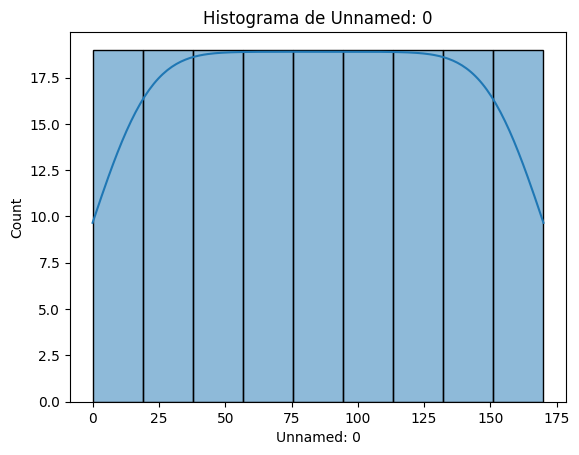

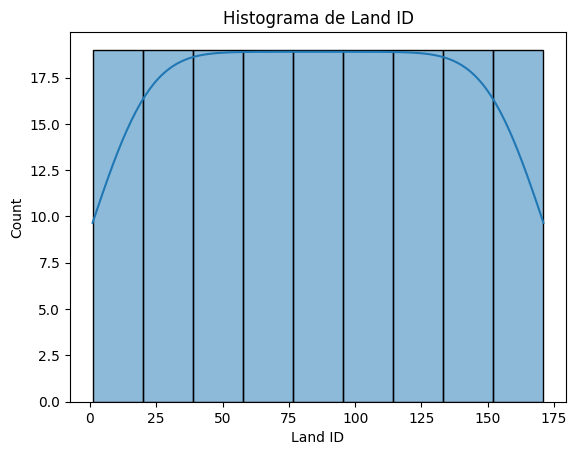

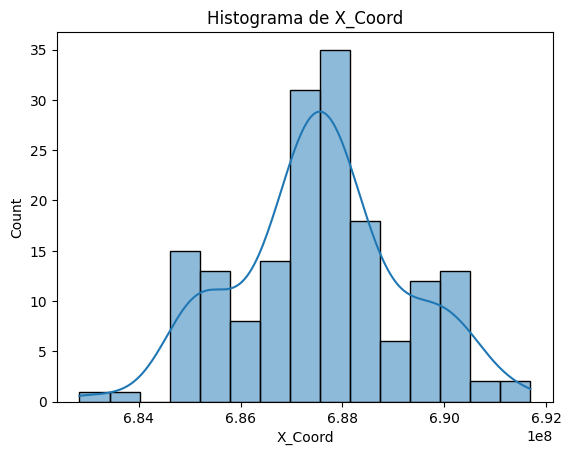

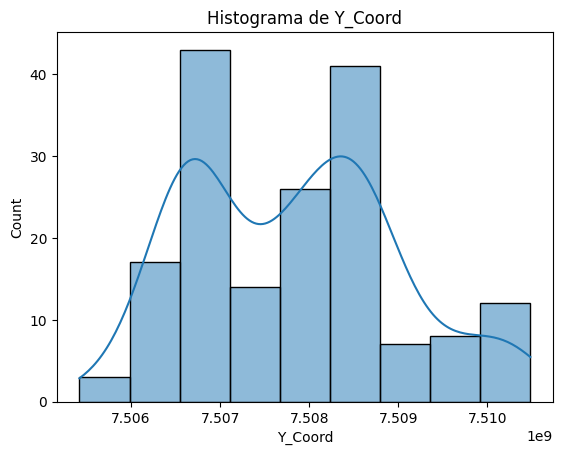

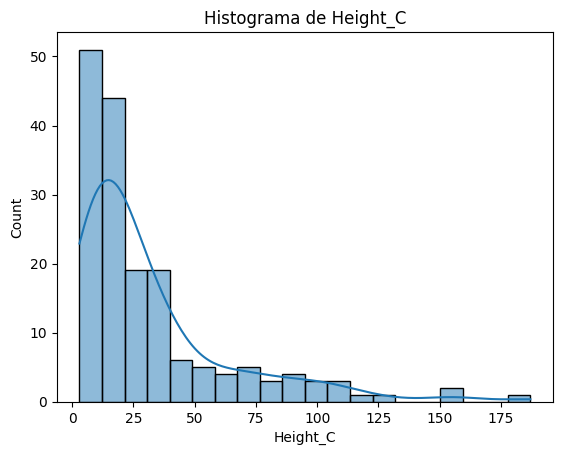

...

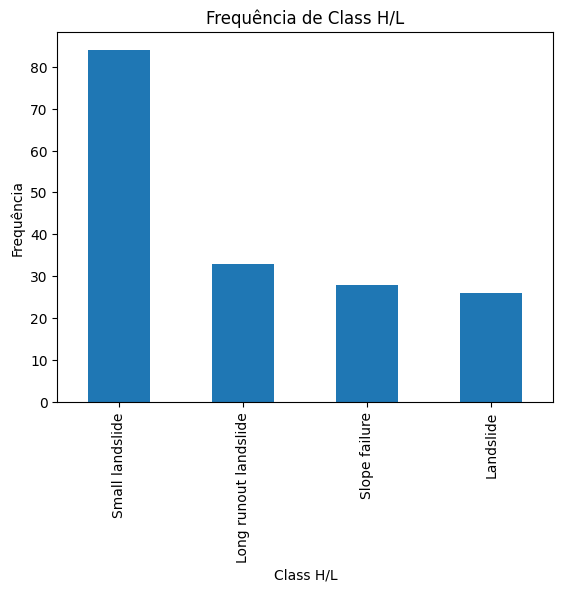

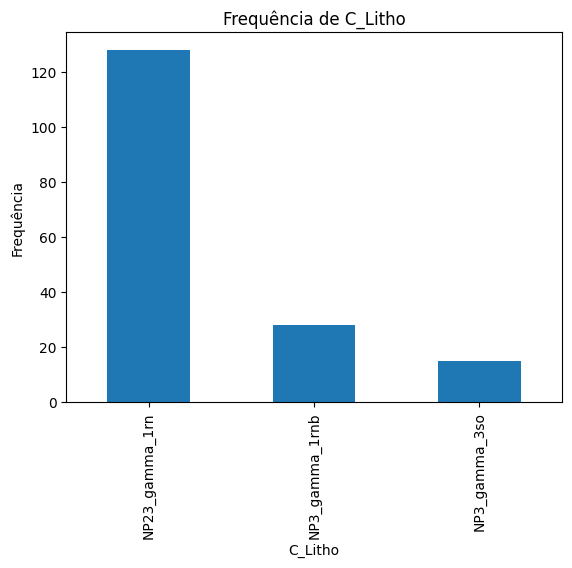

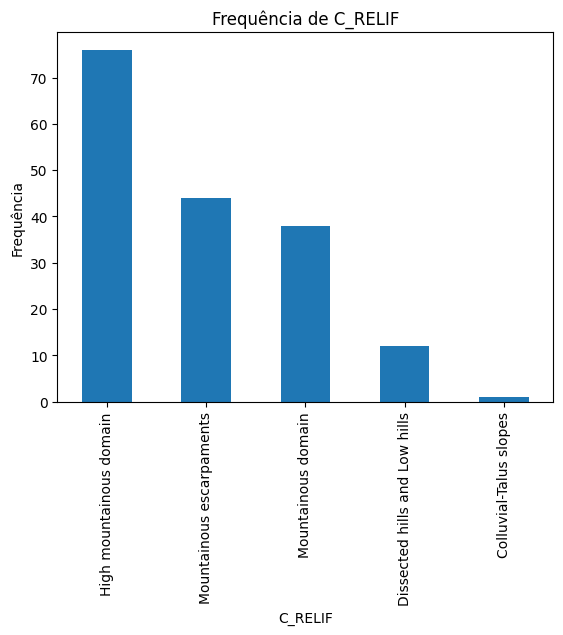

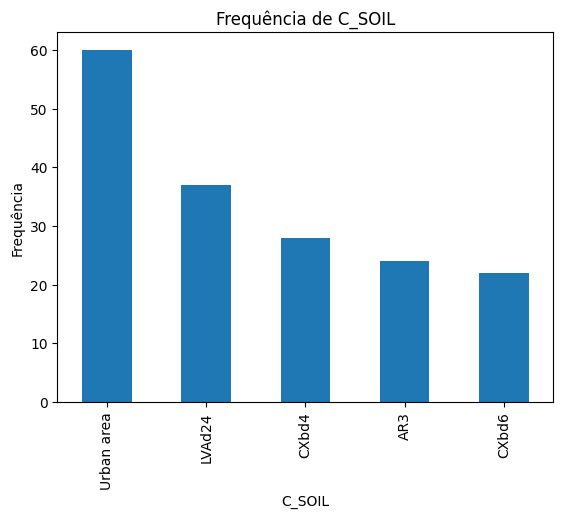

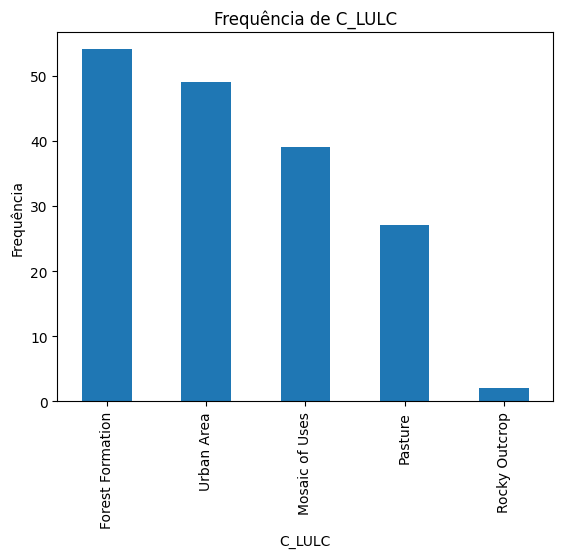

ValueError: could not convert string to float: 'Longitudinal'

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Carregando os dados (substitua pelo caminho correto)
file_path = '/content/colapsed_dataset_240822.csv'
data = pd.read_csv(file_path)

# 1. Entendimento dos Dados
print(data.head())  # Visualizando as primeiras linhas
print(data.info())  # Informações sobre as colunas e tipos de dados
print(data.describe())  # Estatísticas descritivas para colunas numéricas

# 2. Análise Univariada
# Histogramas para variáveis numéricas
for col in data.select_dtypes(include=['float', 'int']).columns:
    plt.figure()
    sns.histplot(data[col], kde=True)
    plt.title(f'Histograma de {col}')
    plt.show()

# Boxplots para variáveis numéricas
for col in data.select_dtypes(include=['float', 'int']).columns:
    plt.figure()
    sns.boxplot(y=data[col])
    plt.title(f'Boxplot de {col}')
    plt.show()

# Gráficos de barras para variáveis categóricas
for col in data.select_dtypes(include=['object', 'category']).columns:
    plt.figure()
    data[col].value_counts().plot(kind='bar')
    plt.title(f'Frequência de {col}')
    plt.xlabel(col)
    plt.ylabel('Frequência')
    plt.show()

# 3. Análise Bivariada
# Matriz de correlação (apenas para variáveis numéricas)
corr_matrix = data.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlação')
plt.show()

# Gráficos de dispersão para pares de variáveis numéricas
sns.pairplot(data, vars=data.select_dtypes(include=['float', 'int']).columns)
plt.show()

# 4. Lidando com Valores Faltantes (se necessário)
# Verificando valores faltantes
print(data.isnull().sum())

# Imputação de valores faltantes (exemplo com a média)
# data.fillna(data.mean(), inplace=True)

# Ou removendo linhas com valores faltantes
# data.dropna(inplace=True)

Fase 1: Entendimento dos Dados

In [19]:
import pandas as pd

def descriptive_analysis(data, save_to_csv=False):
    """
    Performs basic descriptive statistical analysis on a Pandas DataFrame.

    Args:
        data: A Pandas DataFrame containing the data.
        save_to_csv: A boolean flag indicating whether to save the results to a CSV file.

    Returns:
        A Pandas DataFrame containing the descriptive statistics.
    """

    # Calculate descriptive statistics
    desc_stats = data.describe(include='all')

    # Print the results
    print(desc_stats)

    # Save the results to a CSV file if requested
    if save_to_csv:
        file_name = input("_G_COLAB_descriptive_stats.csv")
        desc_stats.to_csv(file_name, index=False)
        print(f"Descriptive statistics saved to {file_name}")

    return desc_stats

# Example usage:
# Load your data (replace 'your_data.csv' with your actual file path)
data = pd.read_csv('/content/colapsed_dataset_240822.csv')

# Perform descriptive analysis and optionally save the results
result = descriptive_analysis(data, save_to_csv=True)

        Unnamed: 0     Land ID       X_Coord       Y_Coord    Height_C  \
count   171.000000  171.000000  1.710000e+02  1.710000e+02  171.000000   
unique         NaN         NaN           NaN           NaN         NaN   
top            NaN         NaN           NaN           NaN         NaN   
freq           NaN         NaN           NaN           NaN         NaN   
mean     85.000000   86.000000  6.875450e+08  7.507817e+09   31.406719   
std      49.507575   49.507575  1.618505e+06  1.166408e+06   32.504806   
min       0.000000    1.000000  6.828373e+08  7.505420e+09    3.000000   
25%      42.500000   43.500000  6.866853e+08  7.506740e+09   11.000000   
50%      85.000000   86.000000  6.875941e+08  7.507859e+09   18.000000   
75%     127.500000  128.500000  6.884006e+08  7.508604e+09   37.000000   
max     170.000000  171.000000  6.916910e+08  7.510484e+09  187.000000   

           Width_C    Length_C       Area_C  Volume (10^3 m^3)_i    L/W_C_GE  \
count   171.000000  171.000000 

In [2]:
import pandas as pd
from google.colab import drive


# Caminho para o arquivo CSV no Colab
caminho_arquivo = '/content/colapsed_dataset_240822.csv'

# Lê o arquivo CSV
dados = pd.read_csv(caminho_arquivo)

# Seleciona apenas as variáveis numéricas
variaveis_numericas = dados.select_dtypes(include=['float', 'int'])

# Calcula as estatísticas descritivas
estatisticas_descritivas = variaveis_numericas.describe(include='all')

# Adiciona a moda às estatísticas
moda = variaveis_numericas.mode().iloc[0]
estatisticas_descritivas.loc['moda'] = moda

# Define a ID da sua pasta no Google Drive
id_pasta = '1e4hIHqlJ2A149c63hHHWjF_cAzmwbLNf'  # Substitua pela ID da sua pasta

# Constrói o caminho completo para salvar a tabela
caminho_tabela = f'/content/drive/My Drive/folders/{id_pasta}/estatisticas_descritivas.csv'

# Salva a tabela na pasta
estatisticas_descritivas.to_csv(caminho_tabela, index=True)

print(f"Tabela de estatísticas descritivas salva em: {caminho_tabela}")



OSError: Cannot save file into a non-existent directory: '/content/drive/My Drive/folders/1e4hIHqlJ2A149c63hHHWjF_cAzmwbLNf'

In [4]:
# Importando as bibliotecas necessárias
import pandas as pd
import numpy as np
from scipy.stats import skew, kurtosis

# Carregando o dataset CSV
file_path = '/content/colapsed_dataset_240822.csv'
df = pd.read_csv(file_path)

# Selecionando apenas as colunas numéricas para a análise
numeric_df = df.select_dtypes(include=[np.number])

# Função para calcular as estatísticas descritivas adicionais
def descriptive_statistics(data):
    statistics = pd.DataFrame()

    # Medidas de tendência central
    statistics['Média'] = data.mean()
    statistics['Mediana'] = data.median()
    statistics['Moda'] = data.mode().iloc[0]  # Considera a primeira moda caso haja mais de uma

    # Medidas de dispersão
    statistics['Desvio Padrão'] = data.std()
    statistics['Variância'] = data.var()
    statistics['Amplitude'] = data.max() - data.min()
    statistics['Q1 (1º Quartil)'] = data.quantile(0.25)
    statistics['Mediana (Q2)'] = data.quantile(0.5)
    statistics['Q3 (3º Quartil)'] = data.quantile(0.75)
    statistics['Intervalo Interquartil (IQR)'] = statistics['Q3 (3º Quartil)'] - statistics['Q1 (1º Quartil)']

    # Outras medidas
    statistics['Assimetria'] = data.apply(skew)
    statistics['Curtose'] = data.apply(kurtosis)

    return statistics

# Calculando as estatísticas descritivas
descriptive_stats = descriptive_statistics(numeric_df)

# Exibindo a tabela interativa no Google Colab
from google.colab import data_table
data_table.DataTable(descriptive_stats, include_index=True)

# Salvando o resultado em um arquivo Excel (.xlsx)
output_file = '/content/analise_descritiva_resultados.xlsx'
descriptive_stats.to_excel(output_file)

print(f'Análise descritiva salva em: {output_file}')


Análise descritiva salva em: /content/analise_descritiva_resultados.xlsx


In [5]:
# Importando as bibliotecas necessárias
import pandas as pd
import numpy as np
from scipy.stats import skew, kurtosis

# Carregando o dataset CSV
file_path = '/content/colapsed_dataset_240822.csv'
df = pd.read_csv(file_path)

# Selecionando apenas as colunas numéricas para a análise
numeric_df = df.select_dtypes(include=[np.number])

# Função para calcular as estatísticas descritivas adicionais
def descriptive_statistics(data):
    statistics = pd.DataFrame()

    # Medidas de tendência central
    statistics['Média'] = data.mean()
    statistics['Mediana'] = data.median()
    statistics['Moda'] = data.mode().iloc[0]  # Considera a primeira moda caso haja mais de uma

    # Medidas de dispersão
    statistics['Desvio Padrão'] = data.std()
    statistics['Variância'] = data.var()
    statistics['Amplitude'] = data.max() - data.min()
    statistics['Q1 (1º Quartil)'] = data.quantile(0.25)
    statistics['Mediana (Q2)'] = data.quantile(0.5)
    statistics['Q3 (3º Quartil)'] = data.quantile(0.75)
    statistics['Intervalo Interquartil (IQR)'] = statistics['Q3 (3º Quartil)'] - statistics['Q1 (1º Quartil)']

    # Outras medidas
    statistics['Assimetria'] = data.apply(skew)
    statistics['Curtose'] = data.apply(kurtosis)

    return statistics

# Calculando as estatísticas descritivas
descriptive_stats = descriptive_statistics(numeric_df)

# Exibindo a tabela interativa no Google Colab usando pandas
from IPython.display import display
display(descriptive_stats)

# Salvando o resultado em um arquivo Excel (.xlsx)
output_file = '/content/analise_descritiva_resultados.xlsx'
descriptive_stats.to_excel(output_file)

print(f'Análise descritiva salva em: {output_file}')


,Média,Mediana,Moda,Desvio Padrão,Variância,Amplitude,Q1 (1º Quartil),Mediana (Q2),Q3 (3º Quartil),Intervalo Interquartil (IQR),Assimetria,Curtose
Unnamed: 0,8.500000e+01,8.500000e+01,0.000000e+00,4.950758e+01,2.451000e+03,1.700000e+02,4.250000e+01,8.500000e+01,1.275000e+02,8.500000e+01,0.000000,-1.200082
Land ID,8.600000e+01,8.600000e+01,1.000000e+00,4.950758e+01,2.451000e+03,1.700000e+02,4.350000e+01,8.600000e+01,1.285000e+02,8.500000e+01,0.000000,-1.200082
X_Coord,6.875450e+08,6.875941e+08,6.828373e+08,1.618505e+06,2.619558e+12,8.853700e+06,6.866853e+08,6.875941e+08,6.884006e+08,1.715314e+06,-0.002453,-0.101546
Y_Coord,7.507817e+09,7.507859e+09,7.505420e+09,1.166408e+06,1.360508e+12,5.064186e+06,7.506740e+09,7.507859e+09,7.508604e+09,1.863780e+06,0.317404,-0.654409
Height_C,3.140672e+01,1.800000e+01,1.500000e+01,3.250481e+01,1.056562e+03,1.840000e+02,1.100000e+01,1.800000e+01,3.700000e+01,2.600000e+01,2.093928,4.764679
Width_C,1.884012e+01,1.654000e+01,1.145000e+01,1.201484e+01,1.443563e+02,7.737000e+01,1.145000e+01,1.654000e+01,2.276000e+01,1.131000e+01,2.076694,5.968129
Length_C,4.373971e+01,2.870000e+01,9.460000e+00,4.308612e+01,1.856414e+03,2.933500e+02,1.689500e+01,2.870000e+01,5.372000e+01,3.682500e+01,2.469579,7.977347
Area_C,8.677255e+02,3.818820e+02,3.055900e+01,1.421472e+03,2.020582e+06,9.297844e+03,1.847090e+02,3.818820e+02,8.651940e+02,6.804850e+02,3.663605,15.340014
Volume (10^3 m^3)_i,7.568406e+01,7.543284e+00,1.444320e-01,2.418414e+02,5.848726e+04,2.060866e+03,2.716055e+00,7.543284e+00,3.993149e+01,3.721543e+01,5.849167,38.439982
L/W_C_GE,2.656682e+00,1.836087e+00,2.760432e-01,2.375460e+00,5.642808e+00,1.447708e+01,1.080386e+00,1.836087e+00,3.412227e+00,2.331840e+00,2.183832,6.267496


Análise descritiva salva em: /content/analise_descritiva_resultados.xlsx


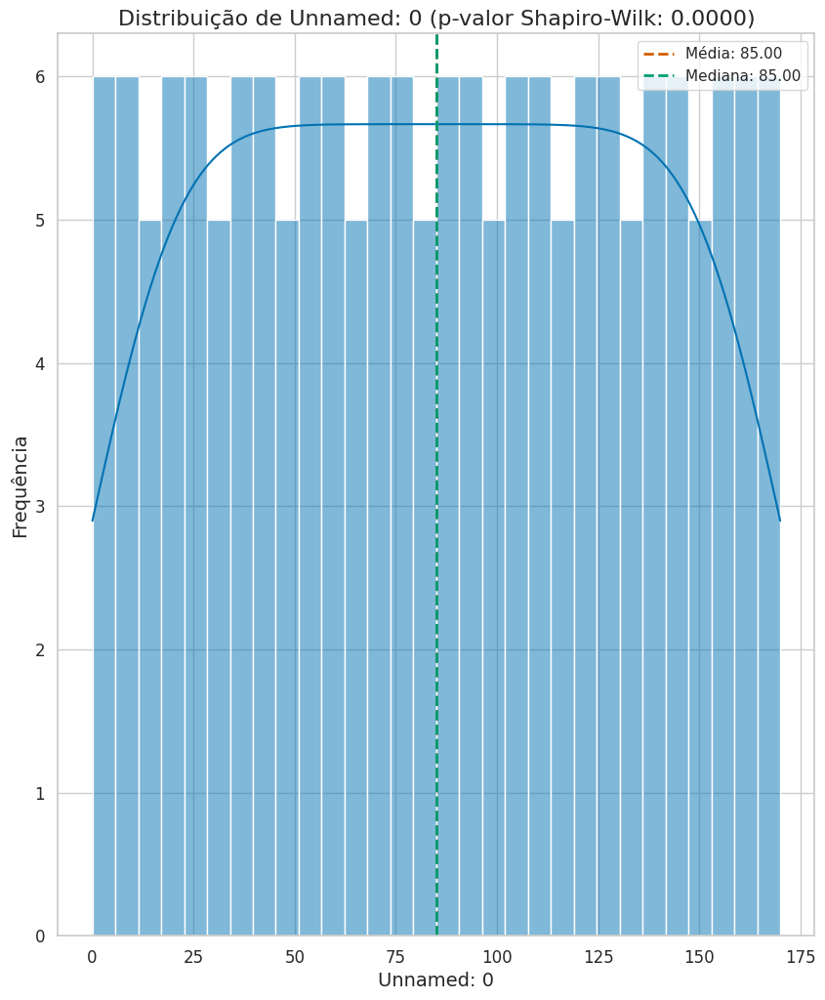

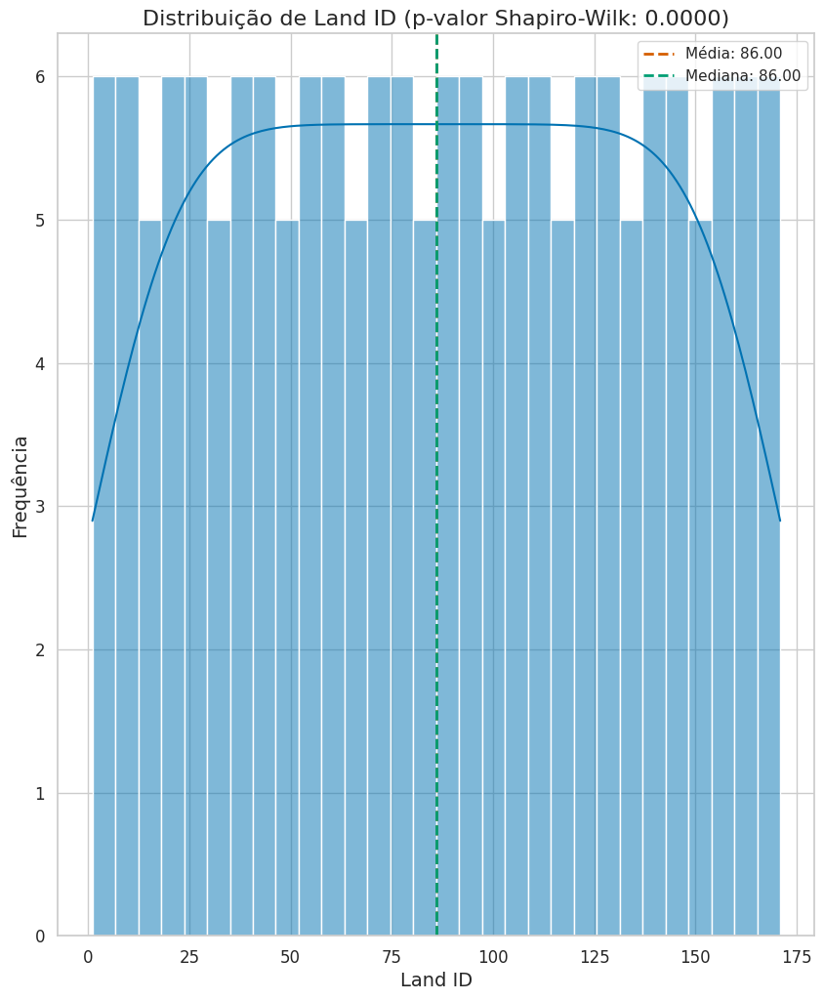

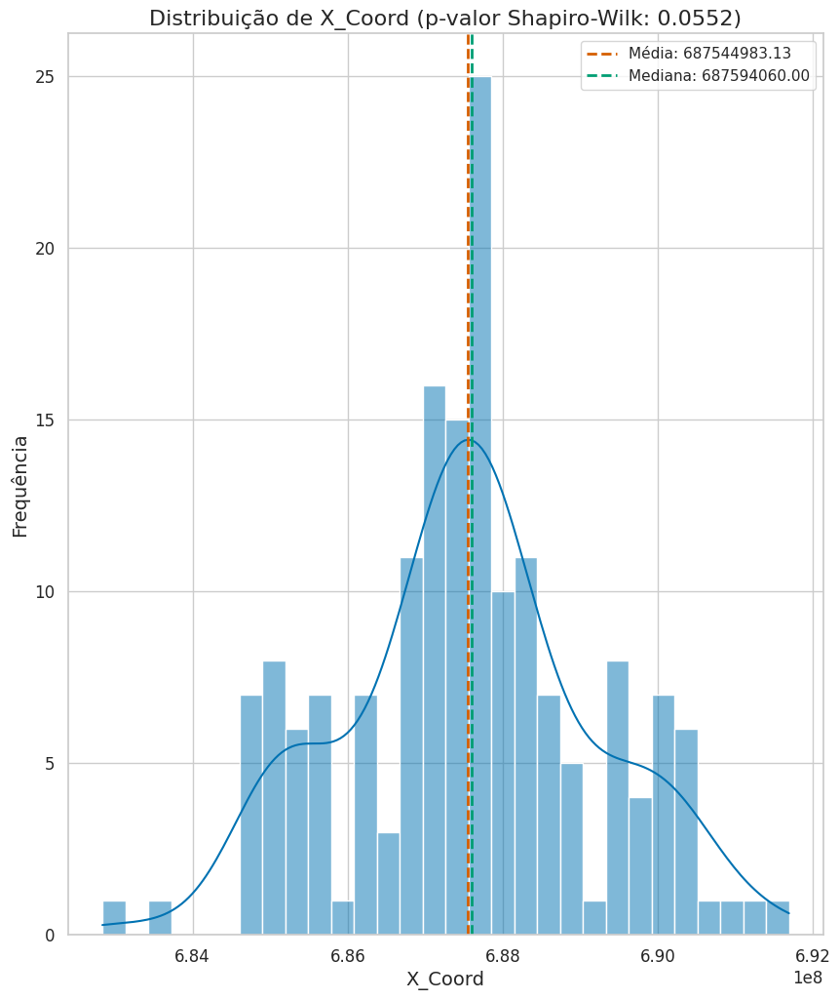

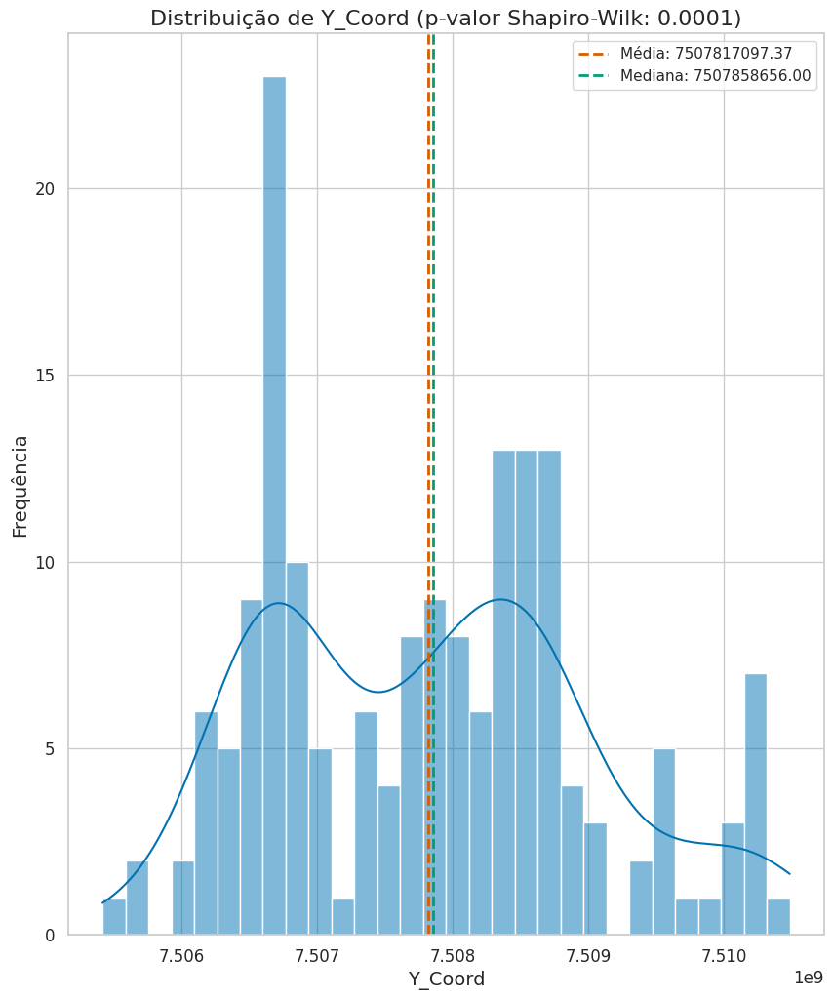

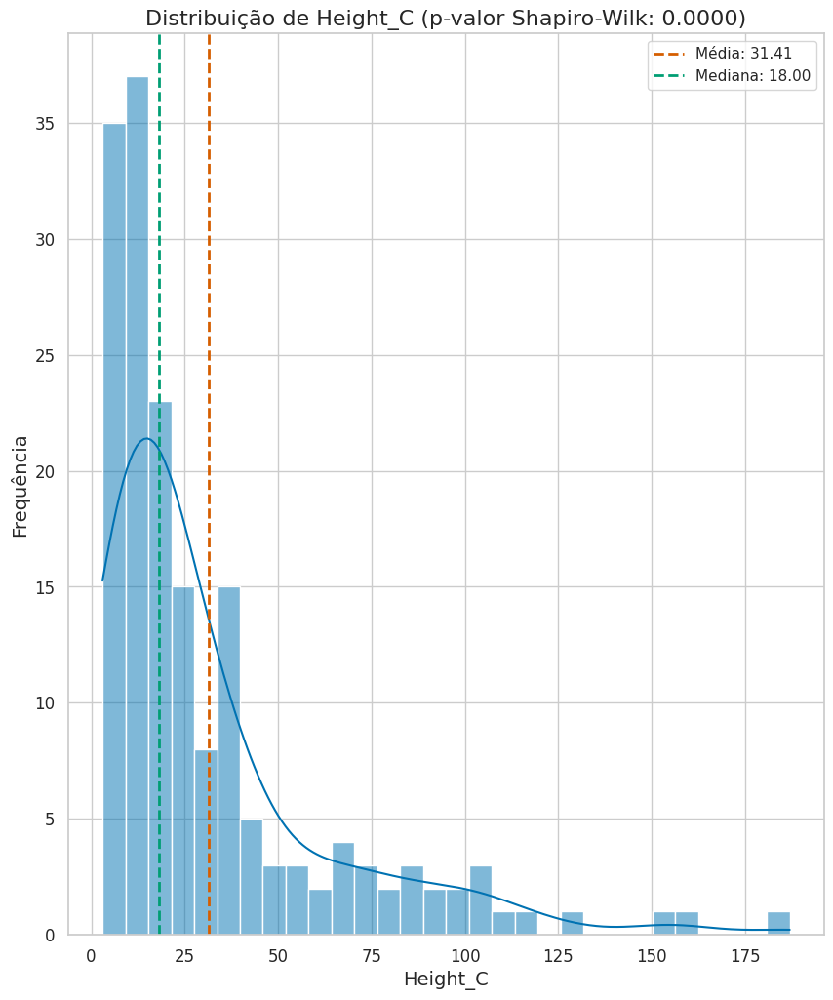

...

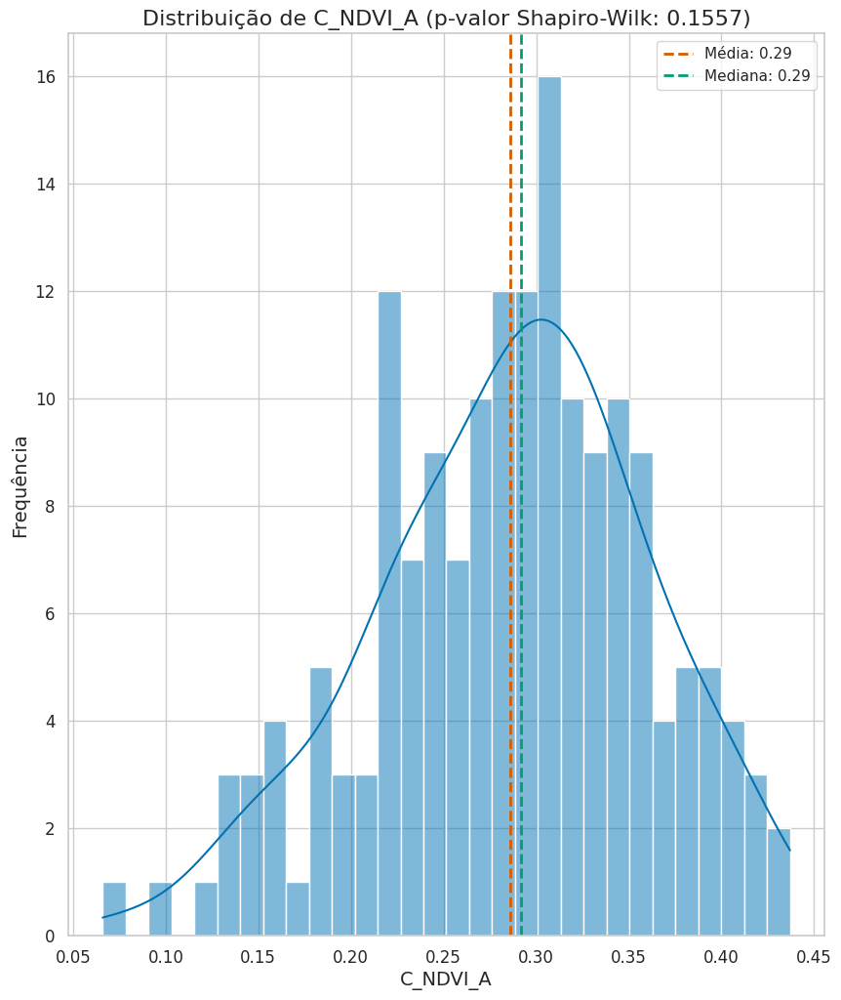

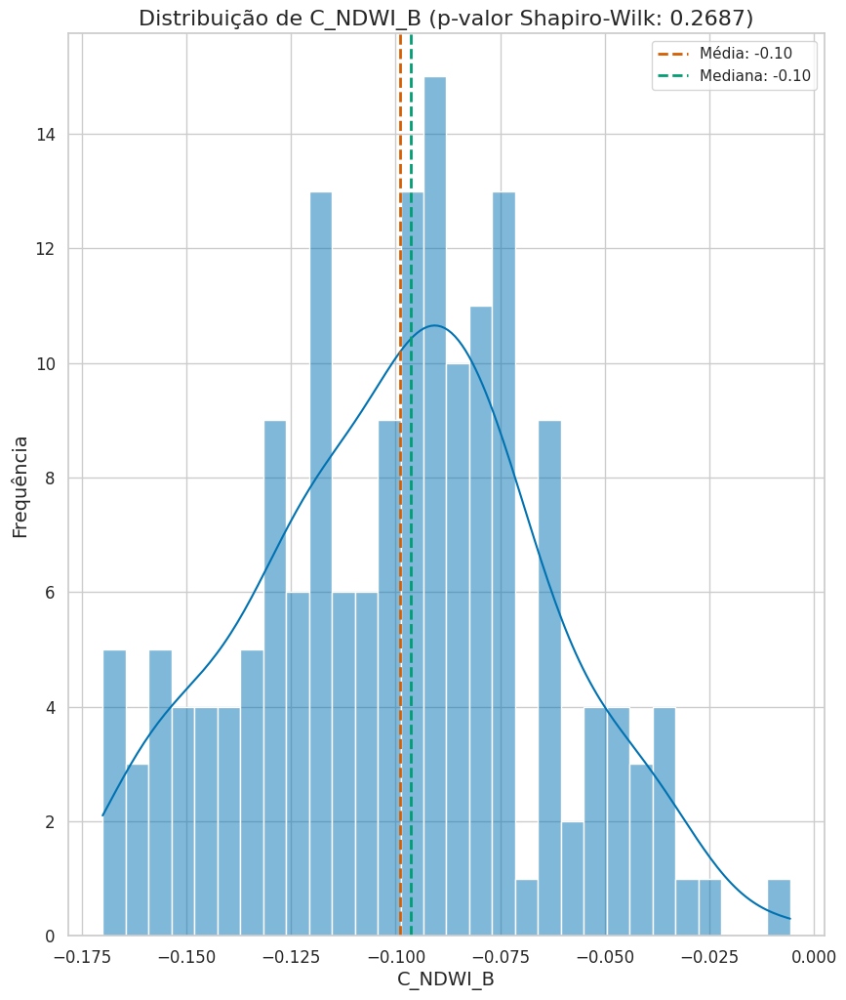

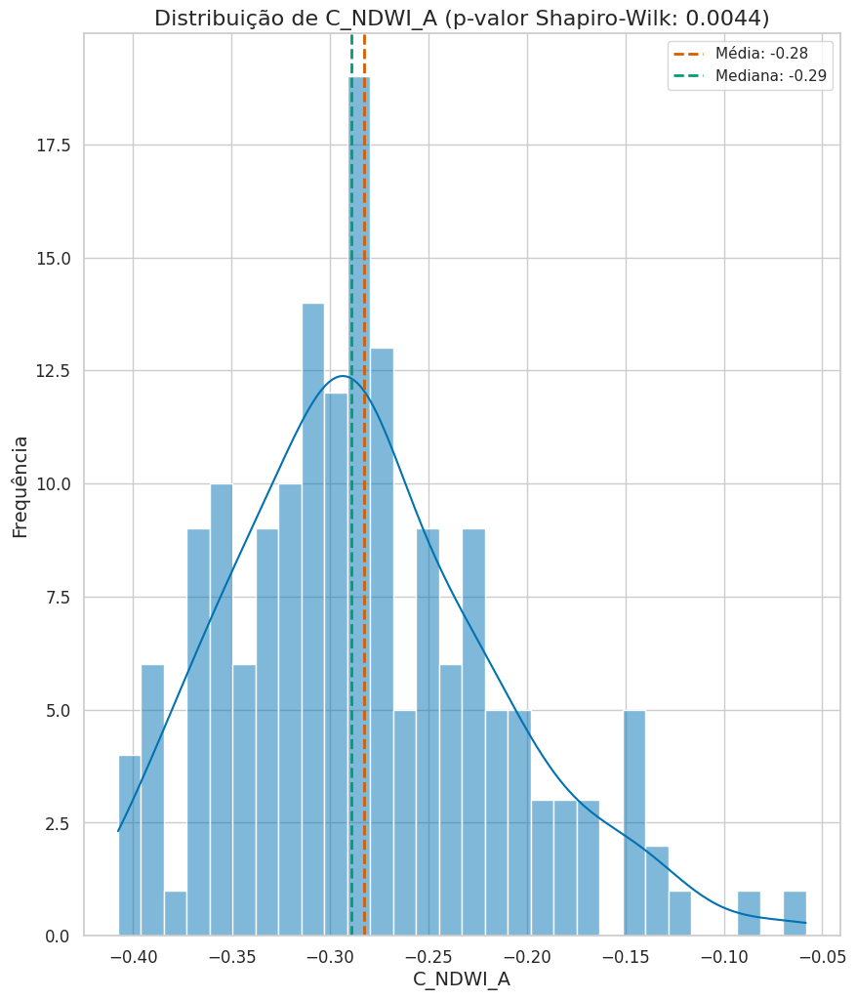

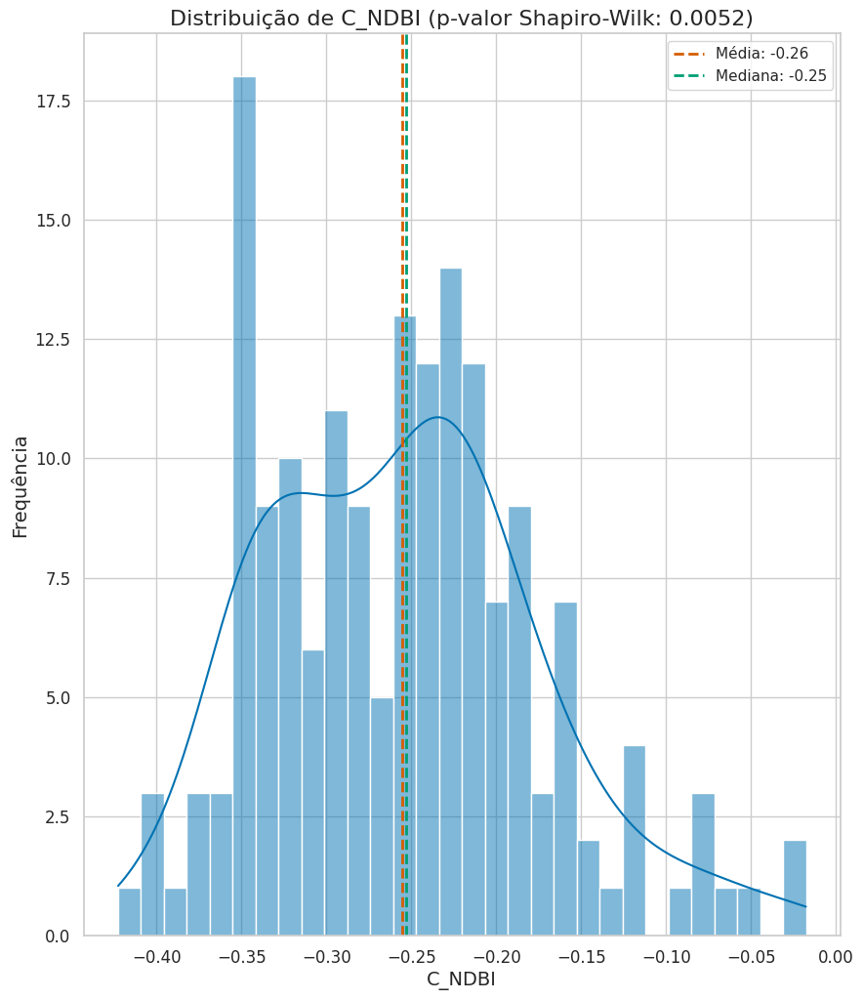

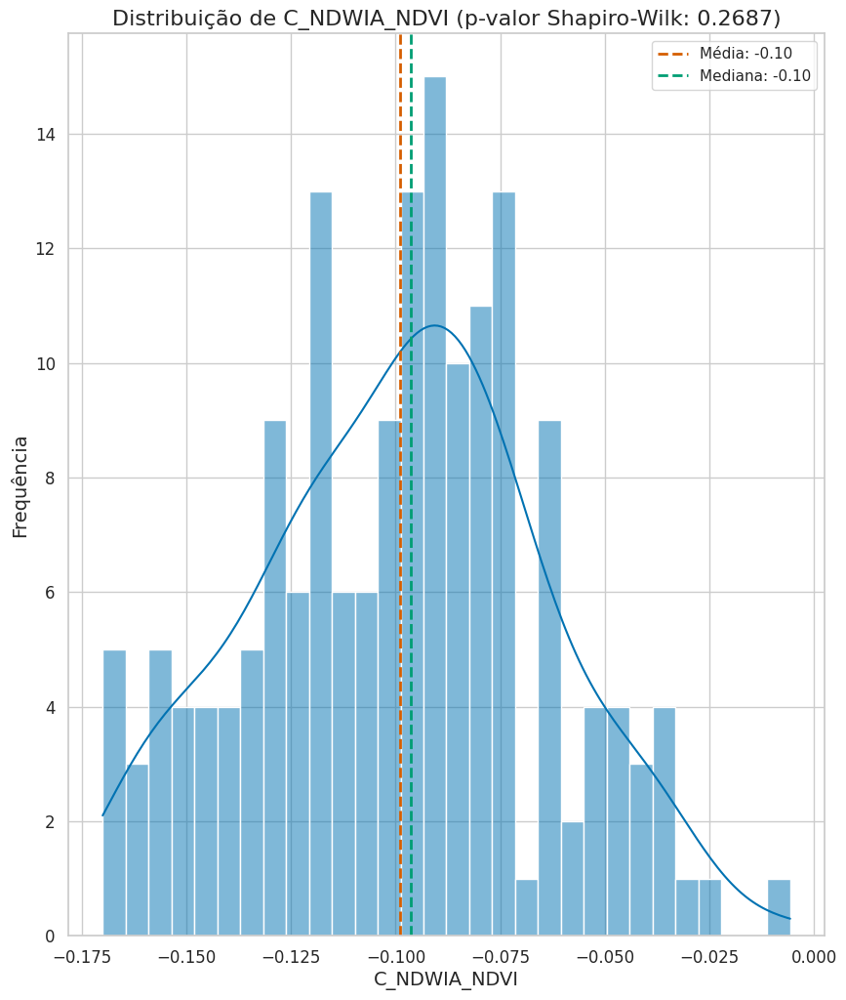

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import shapiro
import re

# Carregando o dataset
file_path = '/content/colapsed_dataset_240822.csv'
df = pd.read_csv(file_path)

# Selecionando apenas as colunas numéricas para a análise
numeric_df = df.select_dtypes(include=[np.number])

# Configurações gerais dos gráficos
sns.set(style="whitegrid")
plt.rcParams['figure.figsize'] = (10, 12)  # Tamanho dos gráficos
plt.rcParams['axes.titlesize'] = 16  # Tamanho do título
plt.rcParams['axes.labelsize'] = 14  # Tamanho dos rótulos dos eixos
plt.rcParams['xtick.labelsize'] = 12  # Tamanho dos rótulos do eixo X
plt.rcParams['ytick.labelsize'] = 12  # Tamanho dos rótulos do eixo Y

# Função para gerar histogramas com densidade, média, mediana e teste de normalidade
def plot_histogram_with_density(data, column_name):
    plt.figure()
    sns.histplot(data[column_name], kde=True, color='#0072B2', bins=30)  # Cor da barra com densidade
    plt.axvline(data[column_name].mean(), color='#D55E00', linestyle='dashed', linewidth=2, label=f'Média: {data[column_name].mean():.2f}')
    plt.axvline(data[column_name].median(), color='#009E73', linestyle='dashed', linewidth=2, label=f'Mediana: {data[column_name].median():.2f}')

    # Teste de normalidade Shapiro-Wilk
    stat, p_value = shapiro(data[column_name].dropna())
    plt.title(f'Distribuição de {column_name} (p-valor Shapiro-Wilk: {p_value:.4f})')
    plt.xlabel(column_name)
    plt.ylabel('Frequência')

    # Legendas acessíveis e visíveis
    plt.legend()

    # Tratamento do nome do arquivo para evitar caracteres inválidos
    safe_column_name = re.sub(r'[^\w\-_\. ]', '_', column_name)
    file_name = f'/content/histograma_{safe_column_name}.png'

    # Salvar o gráfico como imagem
    plt.savefig(file_name, dpi=300)
    plt.show()

# Gerar histogramas para cada variável numérica
for column in numeric_df.columns:
    plot_histogram_with_density(numeric_df, column)


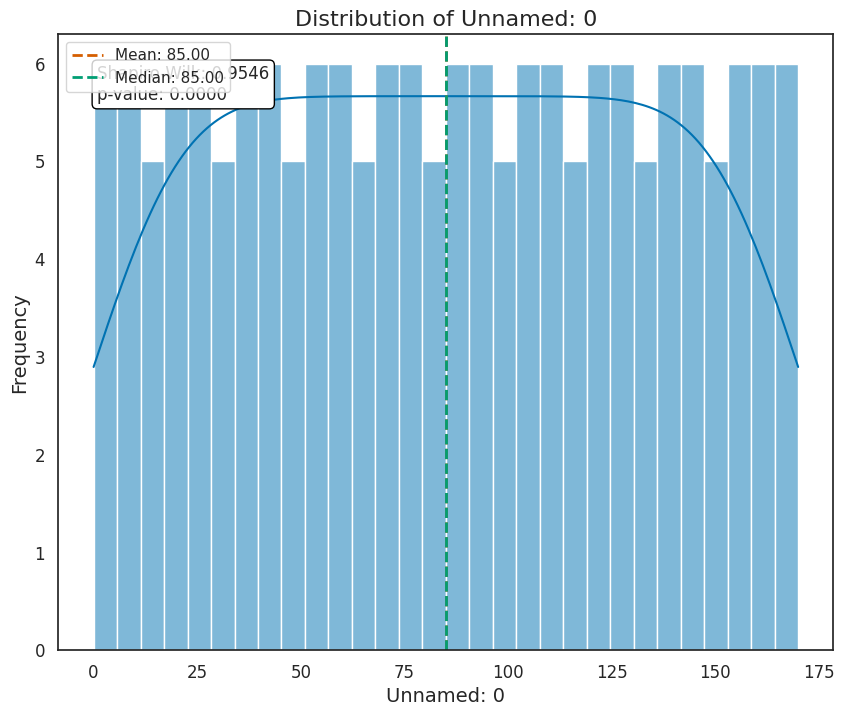

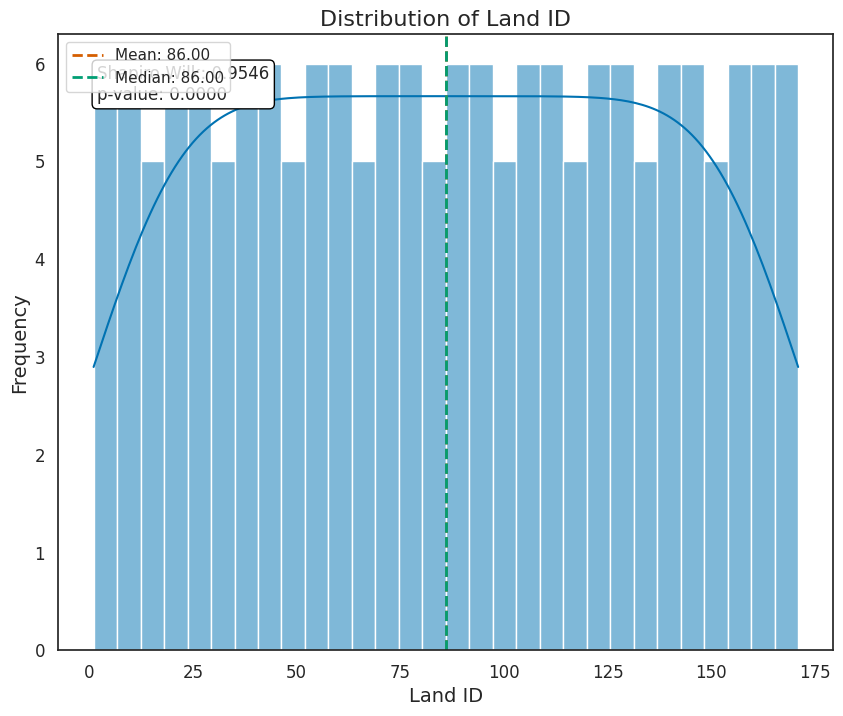

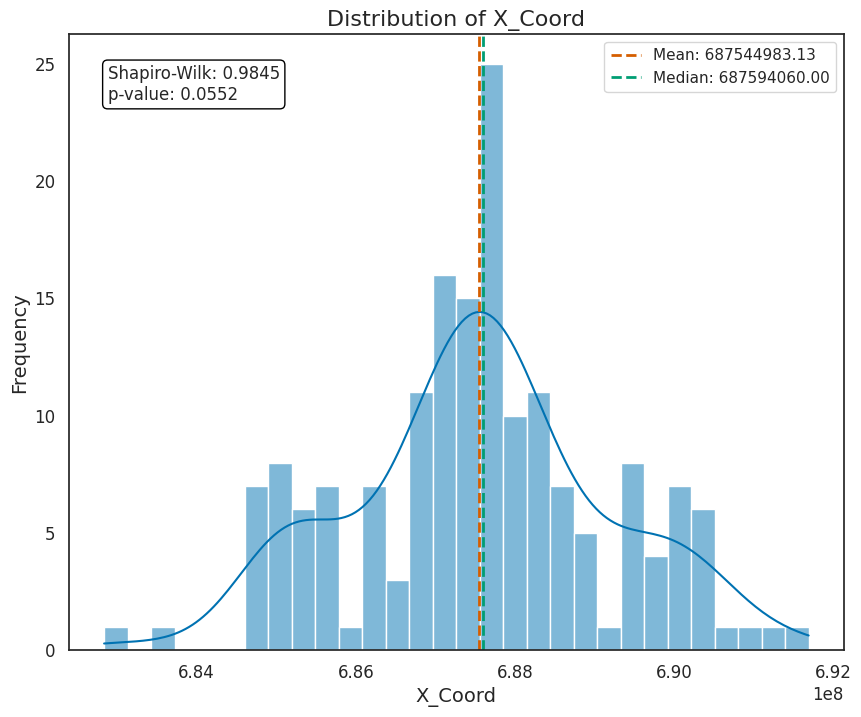

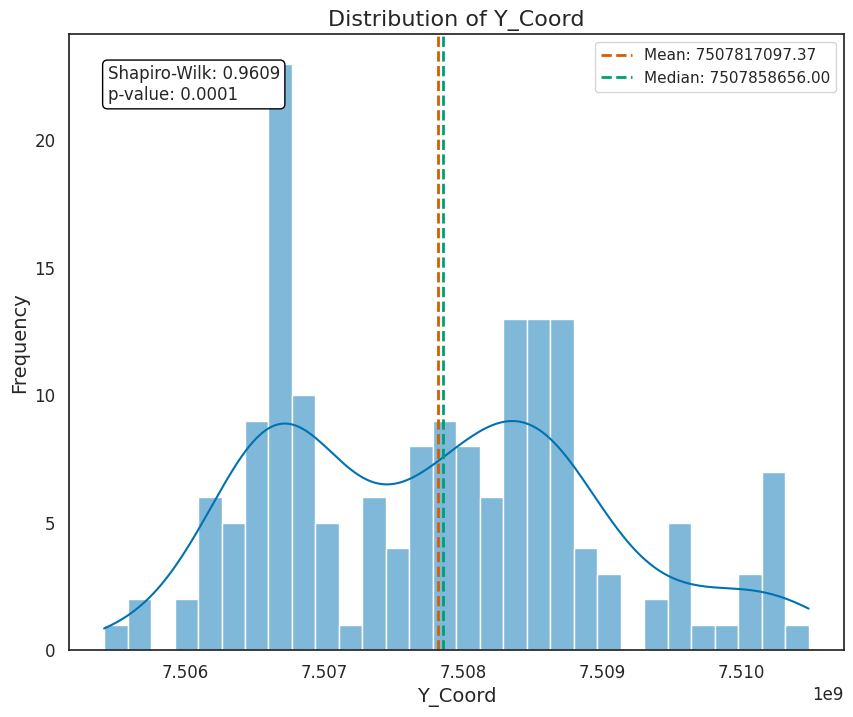

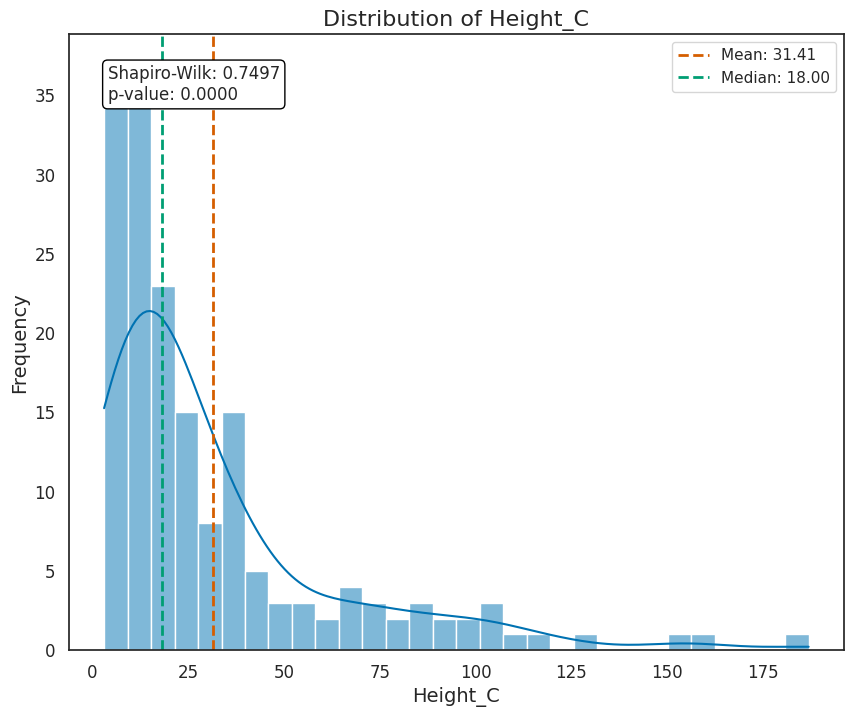

...

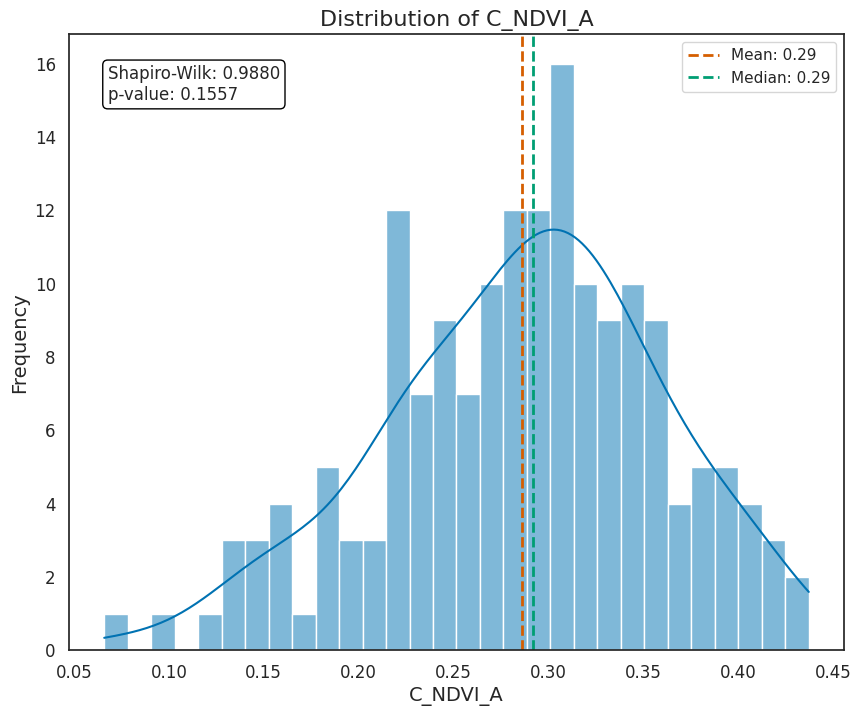

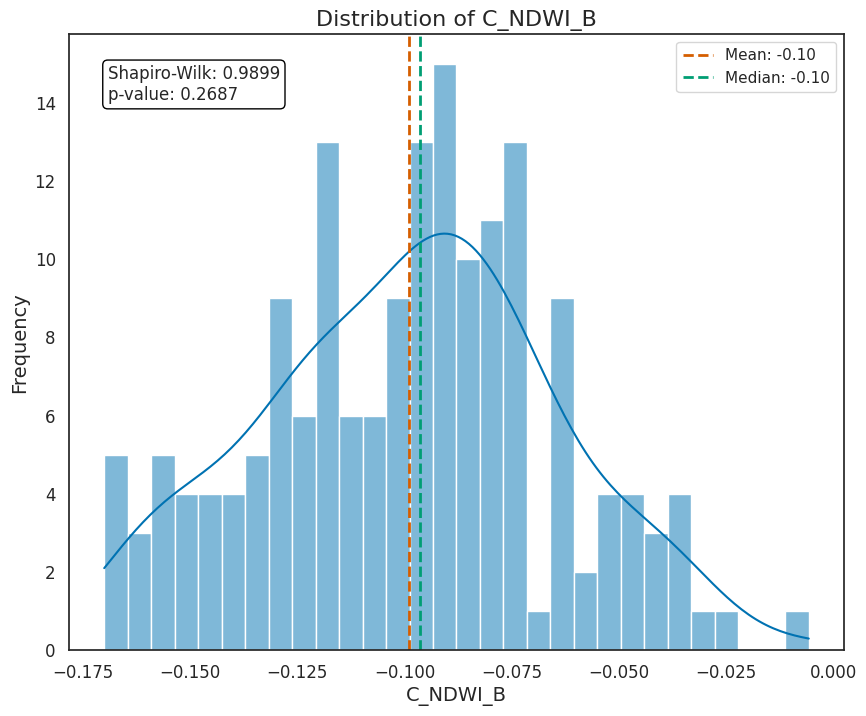

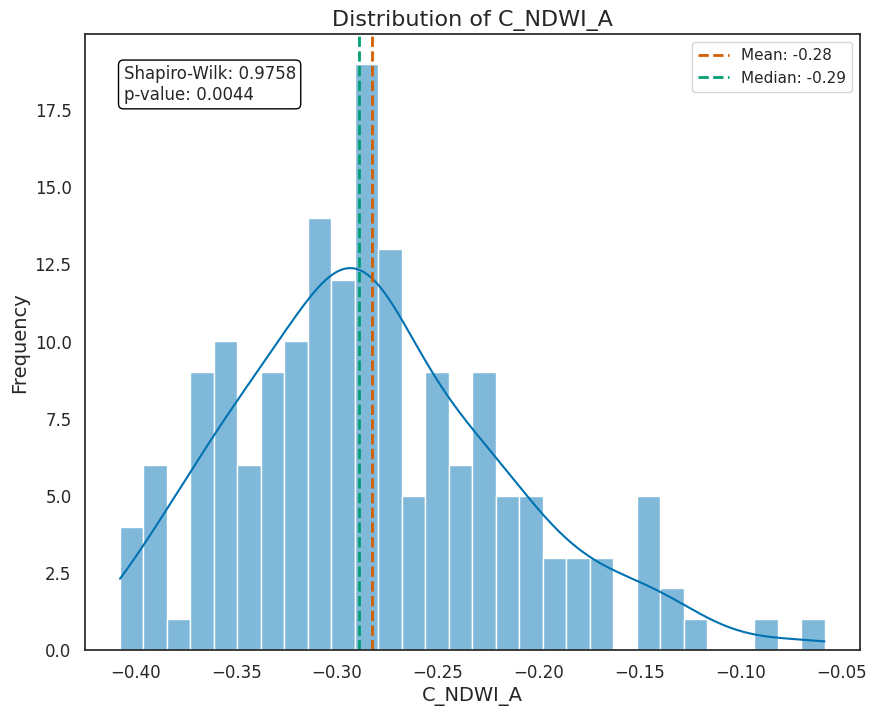

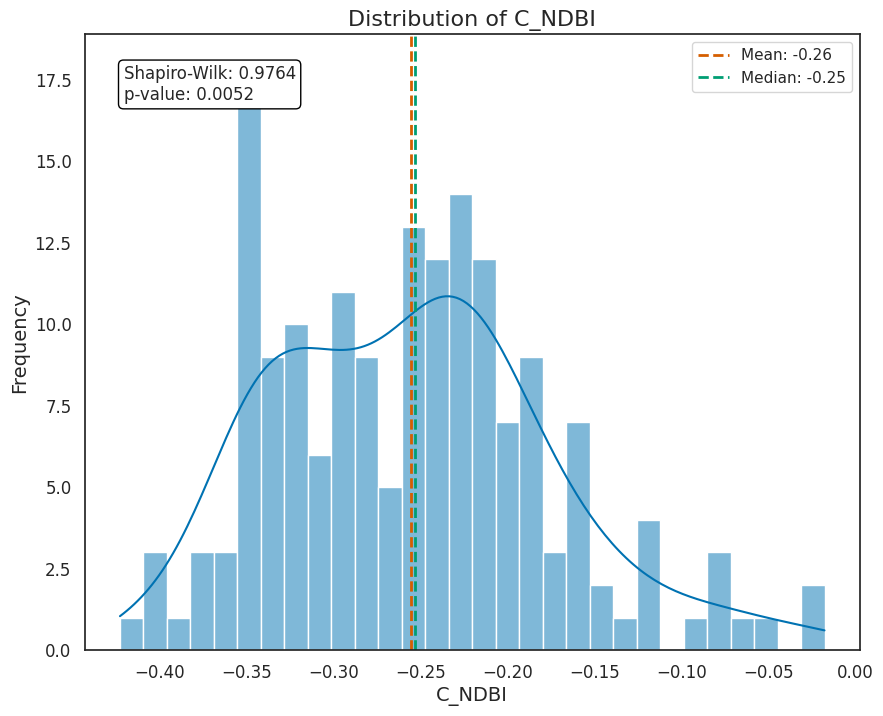

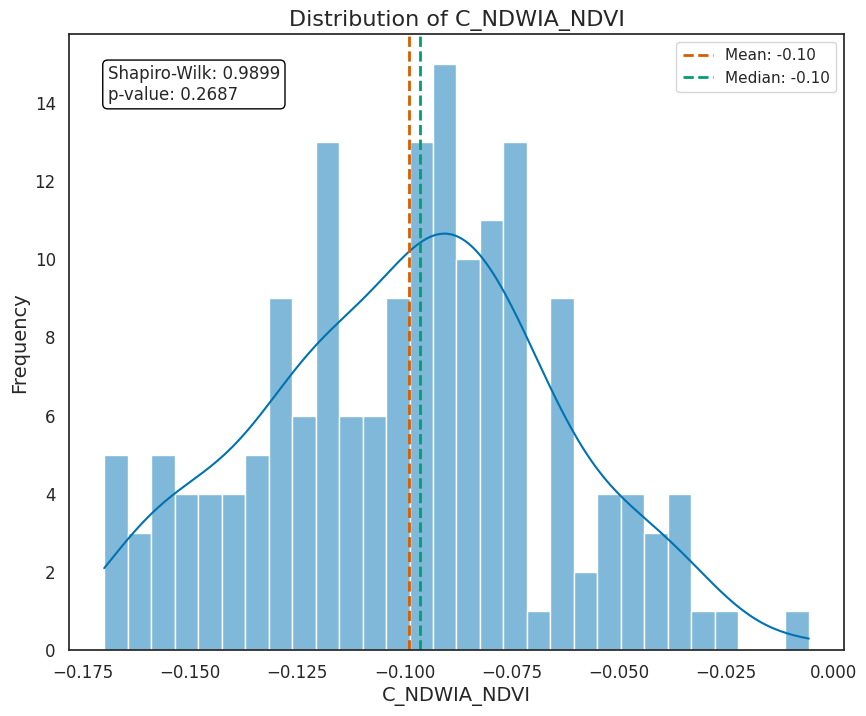

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import shapiro
import re

# Função para gerar histogramas com densidade para todas as variáveis numéricas do dataset
def plot_and_save_all_numeric_histograms(data, numeric_columns):
    for column_name in numeric_columns:
        # Verificação e ajuste do nome da coluna para evitar caracteres inválidos
        safe_column_name = re.sub(r'[^\w\-_\.]', '_', column_name)

        # Certificar-se de que o nome não está vazio
        if not safe_column_name.strip():
            continue  # Ignorar colunas com nomes problemáticos

        plt.figure()

        # Gerar histograma com curva de densidade usando seaborn
        sns.histplot(data[column_name], kde=True, color='#0072B2', bins=30)  # Escolha de cor acessível para daltônicos

        # Adicionar a média e a mediana com linhas tracejadas
        plt.axvline(data[column_name].mean(), color='#D55E00', linestyle='dashed', linewidth=2, label=f'Mean: {data[column_name].mean():.2f}')
        plt.axvline(data[column_name].median(), color='#009E73', linestyle='dashed', linewidth=2, label=f'Median: {data[column_name].median():.2f}')

        # Realizar o teste de normalidade Shapiro-Wilk
        stat, p_value = shapiro(data[column_name].dropna())

        # Exibir o valor do Shapiro-Wilk e o p-value dentro do gráfico, em uma caixa de destaque
        plt.text(0.05, 0.95, f'Shapiro-Wilk: {stat:.4f}\np-value: {p_value:.4f}',
                 transform=plt.gca().transAxes, fontsize=12, verticalalignment='top',
                 bbox=dict(boxstyle='round,pad=0.3', edgecolor='black', facecolor='white'))

        # Título do gráfico e rótulos dos eixos em inglês
        plt.title(f'Distribution of {column_name}')
        plt.xlabel(column_name)
        plt.ylabel('Frequency')

        # Exibir as legendas (média e mediana)
        plt.legend()

        # Salvar o gráfico como imagem em alta resolução no diretório padrão do Colab
        file_name = f'/content/histogram_{safe_column_name}.png'
        plt.savefig(file_name, dpi=300)

        # Mostrar o gráfico na célula do Google Colab
        plt.show()

# Selecionar as colunas numéricas
numeric_columns = df.select_dtypes(include=[np.number]).columns

# Gerar os gráficos para todas as colunas numéricas
plot_and_save_all_numeric_histograms(df, numeric_columns)


In [ ]:
import pandas as pd
from google.colab import drive

def descriptive_analysis(data, save_to_drive=False):
    """
    Performs basic descriptive statistical analysis on a Pandas DataFrame.

    Args:
        data: A Pandas DataFrame containing the data.
        save_to_drive: A boolean flag indicating whether to save the results to Google Drive.

    Returns:
        A Pandas DataFrame containing the descriptive statistics.
    """

    # Calculate descriptive statistics
    desc_stats = data.describe(include='all')

    # Print the results
    print(desc_stats)

    # Save the results to Google Drive if requested
    if save_to_drive:
        drive.mount('/content/drive')  # Monta o Google Drive
        file_path = '/content/drive/My Drive/descriptive_stats.csv'  # Define o caminho no Drive
        desc_stats.to_csv(file_path, index=False)
        print(f"Descriptive statistics saved to {file_path}")

    return desc_stats

# Example usage:
# Load your data (replace 'your_data.csv' with your actual file path)
data = pd.read_csv('your_data.csv')

# Perform descriptive analysis and optionally save the results to Google Drive
result = descriptive_analysis(data, save_to_drive=True)

In [17]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Carregando os dados (substitua pelo caminho correto)
file_path = '/content/colapsed_dataset_240822.csv'
data = pd.read_csv(file_path)

# Visualizando as primeiras linhas
print(data.head())

# Informações sobre as colunas e tipos de dados
print(data.info())

# Estatísticas descritivas para colunas numéricas
print(data.describe())

   Unnamed: 0  Land ID    X_Coord     Y_Coord  Height_C  Width_C  Length_C  \
0           0        1  688396615  7507971764      39.0    27.38     38.27   
1           1        2  687773894  7508162832     157.0    57.34    183.27   
2           2        3  687883218  7508003818      15.0    20.24     21.96   
3           3        4  687799249  7508182763     126.0    17.06    162.40   
4           4        5  688897538  7510082755       7.0    19.19     14.32   

     Area_C  Volume (10^3 m^3)_i  L/W_C_GE  ... C_NDVI_B  C_NDVI_A  C_NDWI_B  \
0  1148.380            40.865471  1.397736  ...  0.30917   0.24517  -0.07813   
1  9328.403          1649.866183  3.196198  ...  0.34165   0.22161  -0.09269   
2   421.837             6.667056  1.084980  ...  0.43088   0.40592  -0.16737   
3  3760.578           349.088544  9.519343  ...  0.35486   0.18575  -0.08243   
4   212.144             1.923606  0.746222  ...  0.28051   0.22088  -0.06179   

   C_NDWI_A   C_NDBI  C_NDWIA_NDVI         C_Litho

Fase 2: Análise Univariada

In [ ]:
# Histogramas para variáveis numéricas
for col in data.select_dtypes(include=['float', 'int']).columns:
    plt.figure()
    sns.histplot(data[col], kde=True)
    plt.title(f'Histograma de {col}')
    plt.show()

# Boxplots para variáveis numéricas
for col in data.select_dtypes(include=['float', 'int']).columns:
    plt.figure()
    sns.boxplot(y=data[col])
    plt.title(f'Boxplot de {col}')
    plt.show()

# Gráficos de barras para variáveis categóricas
for col in data.select_dtypes(include=['object', 'category']).columns:
    plt.figure()
    data[col].value_counts().plot(kind='bar')
    plt.title(f'Frequência de {col}')
    plt.xlabel(col)
    plt.ylabel('Frequência')
    plt.show()

Fase 3: Análise Bivariada

In [ ]:
# Matriz de correlação (apenas para variáveis numéricas)
corr_matrix = data.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlação')
plt.show()

# Gráficos de dispersão para pares de variáveis numéricas
sns.pairplot(data, vars=data.select_dtypes(include=['float', 'int']).columns)
plt.show()

Fase 4: Lidando com Valores Faltantes (se necessário)

Fase 5: Testes Estatísticos

In [ ]:
# Teste de Shapiro-Wilk para normalidade
from scipy.stats import shapiro

for col in data.select_dtypes(include=['float', 'int']).columns:
    statistic, p_value = shapiro(data[col])
    print(f"Teste de Shapiro-Wilk para {col}:")
    print(f"Estatística: {statistic}, Valor-p: {p_value}")
    if p_value > 0.05:
        print("A variável provavelmente segue uma distribuição normal.")
    else:
        print("A variável provavelmente não segue uma distribuição normal.")

# Coeficientes de Pearson e Spearman para correlação
from scipy.stats import pearsonr, spearmanr

for col1 in data.select_dtypes(include=['float', 'int']).columns:
    for col2 in data.select_dtypes(include=['float', 'int']).columns:
        if col1 != col2:
            correlation, p_value = pearsonr(data[col1], data[col2])
            print(f"Coeficiente de Pearson entre {col1} e {col2}:")
            print(f"Correlação: {correlation}, Valor-p: {p_value}")

            correlation, p_value = spearmanr(data[col1], data[col2])
            print(f"Coeficiente de Spearman entre {col1} e {col2}:")
            print(f"Correlação: {correlation}, Valor-p: {p_value}")

In [ ]:
# Verificando valores faltantes
print(data.isnull().sum())

# Imputação de valores faltantes (exemplo com a média)
# data.fillna(data.mean(), inplace=True)

# Ou removendo linhas com valores faltantes
# data.dropna(inplace=True)

Fontes
www.geeksforgeeks.org/exploratory-data-analysis-in-python/
www.kaggle.com/code/imoore/intro-to-exploratory-data-analysis-eda-in-python
dev.to/phylis/how-to-perform-exploratory-data-analysis-with-python-l8j
www.simplilearn.com/tutorials/data-analytics-tutorial/exploratory-data-analysis

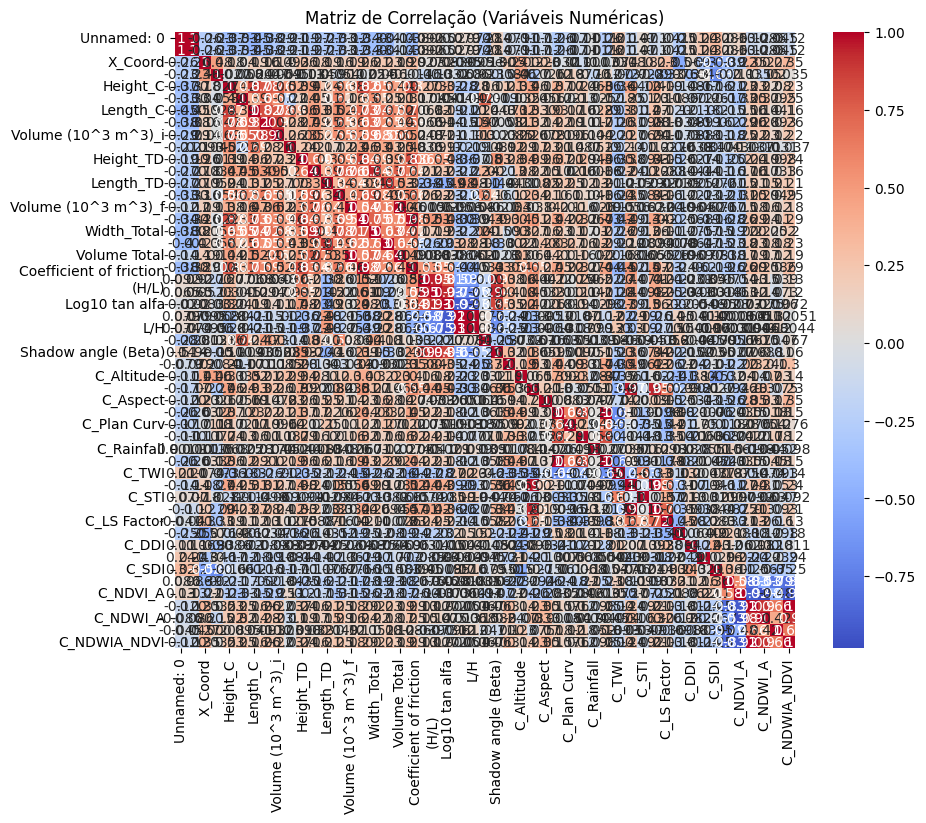

Teste Qui-Quadrado entre Land_C_Class e Land_TD_Class:
Chi2 estatística: 11.524493196504729
Valor-p: 0.24146188280353836
------------------------------
Teste Qui-Quadrado entre Land_C_Class e Class H/L:
Chi2 estatística: 40.484029802532135
Valor-p: 6.207794085555208e-06
------------------------------
Teste Qui-Quadrado entre Land_C_Class e C_Litho:
Chi2 estatística: 8.00763533793025
Valor-p: 0.2375444549003234
------------------------------
Teste Qui-Quadrado entre Land_C_Class e C_RELIF:
Chi2 estatística: 13.098112209721867
Valor-p: 0.3619500006877542
------------------------------
Teste Qui-Quadrado entre Land_C_Class e C_SOIL:
Chi2 estatística: 31.709349836086403
Valor-p: 0.0015340621243578876
------------------------------
Teste Qui-Quadrado entre Land_C_Class e C_LULC:
Chi2 estatística: 29.131574482171725
Valor-p: 0.003766530917040029
------------------------------
Teste Qui-Quadrado entre Land_TD_Class e Class H/L:
Chi2 estatística: 15.10732229954919
Valor-p: 0.08802988750154929


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import chi2_contingency

# Carregando os dados (substitua pelo caminho correto)
file_path = '/content/colapsed_dataset_240822.csv'
data = pd.read_csv(file_path)

# Separando variáveis numéricas e categóricas
numerical_data = data.select_dtypes(include=['float', 'int'])
categorical_data = data.select_dtypes(include=['object', 'category'])

# 1. Análise de Variáveis Numéricas
# Matriz de correlação
corr_matrix = numerical_data.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlação (Variáveis Numéricas)')
plt.show()

# Gráficos de dispersão para pares de variáveis numéricas
sns.pairplot(numerical_data, vars=numerical_data.columns)
plt.show()

# 2. Análise de Variáveis Categóricas
# Teste Qui-Quadrado
for i in range(len(categorical_data.columns)):
    for j in range(i + 1, len(categorical_data.columns)):
        col1 = categorical_data.columns[i]
        col2 = categorical_data.columns[j]
        contingency_table = pd.crosstab(categorical_data[col1], categorical_data[col2])
        chi2, p, dof, expected = chi2_contingency(contingency_table)
        print(f"Teste Qui-Quadrado entre {col1} e {col2}:")
        print(f"Chi2 estatística: {chi2}")
        print(f"Valor-p: {p}")
        print("-" * 30)

# 3. Lidando com Valores Faltantes (se necessário)
# Verificando valores faltantes
print(data.isnull().sum())

# Imputação de valores faltantes (exemplo com a média)
# data.fillna(data.mean(), inplace=True)

# Ou removendo linhas com valores faltantes
# data.dropna(inplace=True)

Fontes
stackoverflow.com/questions/77038580/could-not-convert-string-to-float-from-pandas-dataframe
stackoverflow.com/questions/68406930/getting-cant-convert-string-to-float-error-using-pandas-and-python
www.geeksforgeeks.org/how-to-handle-pandas-value-error-could-not-convert-string-to-float/
saturncloud.io/blog/how-to-handle-the-pandas-valueerror-could-not-convert-string-to-float/
www.statology.org/pandas-could-not-convert-string-to-float/
stackoverflow.com/questions/48035381/correlation-among-multiple-categorical-variables

1. Teste de Shapiro-Wilk:

Objetivo: Verificar se uma variável numérica segue uma distribuição normal.

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Carregando os dados (substitua pelo caminho correto)
file_path = '/content/colapsed_dataset_240822.xls'
data = pd.read_csv(file_path)

# Separando variáveis numéricas
numerical_data = data.select_dtypes(include=['float', 'int'])

# Calculando a matriz de correlação
corr_matrix = numerical_data.corr()

# Criando um heatmap sem números e com cores
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=False, cmap='coolwarm')  # Removendo anotações (números)
plt.title('Matriz de Correlação (Variáveis Numéricas)')

# Salvando a figura
plt.savefig('matriz_correlacao_sem_numeros.png')  # Salvando a matriz de correlação sem números
plt.show()

# Salvando a tabela de correlação em um arquivo CSV
corr_matrix.to_csv('matriz_correlacao.csv', index=False)  # Salvando a tabela em um arquivo CSV

print("Figura e tabela de correlação salvas com sucesso!")

FileNotFoundError: [Errno 2] No such file or directory: '/content/colapsed_dataset_240822.xls'

In [34]:
from scipy.stats import shapiro

for col in data.select_dtypes(include=['float', 'int']).columns:
    statistic, p_value = shapiro(data[col])
    print(f"Teste de Shapiro-Wilk para {col}:")
    print(f"Estatística: {statistic}, Valor-p: {p_value}")
    if p_value > 0.05:
        print("A variável provavelmente segue uma distribuição normal.")
    else:
        print("A variável provavelmente não segue uma distribuição normal.")

Teste de Shapiro-Wilk para Unnamed: 0:
Estatística: 0.9546090122811103, Valor-p: 2.4972979423547948e-05
A variável provavelmente não segue uma distribuição normal.
Teste de Shapiro-Wilk para Land ID:
Estatística: 0.9546090122811103, Valor-p: 2.4972979423547948e-05
A variável provavelmente não segue uma distribuição normal.
Teste de Shapiro-Wilk para X_Coord:
Estatística: 0.9845483845321107, Valor-p: 0.05521902500737493
A variável provavelmente segue uma distribuição normal.
Teste de Shapiro-Wilk para Y_Coord:
Estatística: 0.9608943586581675, Valor-p: 0.00010133052738895231
A variável provavelmente não segue uma distribuição normal.
Teste de Shapiro-Wilk para Height_C:
Estatística: 0.7496936504165922, Valor-p: 9.10209525095725e-16
A variável provavelmente não segue uma distribuição normal.
Teste de Shapiro-Wilk para Width_C:
Estatística: 0.8215456163550992, Valor-p: 3.4676388246258276e-13
A variável provavelmente não segue uma distribuição normal.
Teste de Shapiro-Wilk para Length_C:
Es

2. Coeficiente de Pearson:

Objetivo: Medir a correlação linear entre duas variáveis numéricas.

In [35]:
from scipy.stats import pearsonr

for col1 in data.select_dtypes(include=['float', 'int']).columns:
    for col2 in data.select_dtypes(include=['float', 'int']).columns:
        if col1 != col2:
            correlation, p_value = pearsonr(data[col1], data[col2])
            print(f"Coeficiente de Pearson entre {col1} e {col2}:")
            print(f"Correlação: {correlation}, Valor-p: {p_value}")

A saída de streaming foi truncada nas últimas 5000 linhas.
Coeficiente de Pearson entre X_Coord e C_NDWI_A:
Correlação: 0.20060100512399617, Valor-p: 0.008519546552088959
Coeficiente de Pearson entre X_Coord e C_NDBI:
Correlação: 0.2671695858669499, Valor-p: 0.0004116431662519162
Coeficiente de Pearson entre X_Coord e C_NDWIA_NDVI:
Correlação: 0.3461236535180997, Valor-p: 3.5332932875353778e-06
Coeficiente de Pearson entre Y_Coord e Unnamed: 0:
Correlação: -0.23395392007095636, Valor-p: 0.0020716619230319185
Coeficiente de Pearson entre Y_Coord e Land ID:
Correlação: -0.23395392007095636, Valor-p: 0.0020716619230319185
Coeficiente de Pearson entre Y_Coord e X_Coord:
Correlação: 0.4771208481936512, Valor-p: 4.178894407328671e-11
Coeficiente de Pearson entre Y_Coord e Height_C:
Correlação: -0.026674533387965996, Valor-p: 0.7291037488279217
Coeficiente de Pearson entre Y_Coord e Width_C:
Correlação: -0.05787574891014995, Valor-p: 0.45210930850291653
Coeficiente de Pearson entre Y_Coord e 

Coeficiente de Spearman:

Objetivo: Medir a correlação monotônica (não necessariamente linear) entre duas variáveis (numéricas ou ordinais).

In [36]:
from scipy.stats import spearmanr

for col1 in data.select_dtypes(include=['float', 'int', 'object', 'category']).columns:
    for col2 in data.select_dtypes(include=['float', 'int', 'object', 'category']).columns:
        if col1 != col2:
            correlation, p_value = spearmanr(data[col1], data[col2])
            print(f"Coeficiente de Spearman entre {col1} e {col2}:")
            print(f"Correlação: {correlation}, Valor-p: {p_value}")

A saída de streaming foi truncada nas últimas 5000 linhas.
Coeficiente de Spearman entre Volume (10^3 m^3)_f e C_NDWI_B:
Correlação: 0.27343712500434997, Valor-p: 0.00029615654561709046
Coeficiente de Spearman entre Volume (10^3 m^3)_f e C_NDWI_A:
Correlação: 0.2133377173217622, Valor-p: 0.005084704574897493
Coeficiente de Spearman entre Volume (10^3 m^3)_f e C_NDBI:
Correlação: 0.17214764255148832, Valor-p: 0.02435727768650002
Coeficiente de Spearman entre Volume (10^3 m^3)_f e C_NDWIA_NDVI:
Correlação: 0.27343712500434997, Valor-p: 0.00029615654561709046
Coeficiente de Spearman entre Volume (10^3 m^3)_f e C_Litho:
Correlação: -0.1577801055827213, Valor-p: 0.03929947798110609
Coeficiente de Spearman entre Volume (10^3 m^3)_f e C_RELIF:
Correlação: 0.2044315948284307, Valor-p: 0.007316854897230335
Coeficiente de Spearman entre Volume (10^3 m^3)_f e C_SOIL:
Correlação: -0.16207856839123785, Valor-p: 0.03418090618733572
Coeficiente de Spearman entre Volume (10^3 m^3)_f e C_LULC:
Correlaç

Interpretação:

Shapiro-Wilk: Se o valor-p for maior que 0.05, geralmente aceitamos a hipótese de que a variável segue uma distribuição normal.
Pearson e Spearman: O coeficiente de correlação varia de -1 a 1, onde -1 indica correlação negativa perfeita, 0 indica ausência de correlação e 1 indica correlação positiva perfeita. O valor-p indica a significância estatística da correlação.
Observações:

Normalidade: A normalidade dos dados é uma suposição importante para muitos testes estatísticos. Se os dados não forem normais, você pode precisar considerar transformações ou testes não paramétricos.
Causalidade: Correlação não implica causalidade. Uma correlação forte entre duas variáveis não significa que uma causa a outra.
Tamanho da Amostra: O tamanho da sua amostra afeta a significância estatística dos resultados.
Com essas análises, você poderá entender melhor a distribuição dos seus dados e as relações entre as variáveis, o que te ajudará a tomar decisões mais informadas na construção dos seus modelos preditivos.

Se tiver mais dúvidas ou quiser explorar outras análises, me avise! 😊

Fontes
docs.scipy.org/doc/scipy/reference/generated/scipy.stats.spearmanr.html

# 5) Data Treatment

 Limpeza e organização dos dados: Verificar se há valores ausentes, outliers e inconsistências.

Tratar com o MonteCarlo - Verificar e quantificar as incertezas

Normalização e Padronização:
Deseja aplicar normalização/padronização a todas as variáveis ou apenas a algumas específicas?


# 6) Feature Engineering

Criar novos parametros (EXEMPLO: Coeficiente de Susceptibilidade)
Outra ideia: Criar novas variaveis a partir dos dados existentes. Por exemplo: criar um coeficiente que analise a distancia das coordenadas dos deslizamentos com o indice de densidade da malha viaria para ver a influencia deste parametro.


Será importante lidar com os dados categóricos (tipo de solo, litologia, etc.) utilizando técnicas como one-hot encoding. A normalização ou padronização das variáveis numéricas também pode ser necessária.
Engenharia de Atributos: Você pode considerar criar novas variáveis combinando as existentes, como por exemplo, um índice que represente a suscetibilidade do terreno a deslizamentos com base nas variáveis topográficas e de solo.


Analise de incertezas

Analisar as incertezas usando **Monte Carlo**: Essa técnica permite simular diversas vezes o seu modelo, variando os parâmetros de entrada dentro de um intervalo de incerteza, para entender como essas incertezas afetam os resultados da sua previsão.

# 7) Factor Analysis and Feature Selection

Estatísticas Descritivas: Analisar a distribuição das variáveis.
Visualização: Criar gráficos e mapas para identificar padrões e relações entre as variáveis.
Frequency Ratio (FR): Realizar análise fatorial para identificar os fatores mais importantes.
Multicolinearidade: Avaliar a multicolinearidade usando VIF, TOL e determinante da matriz de correlação.

Frequency Ratio (FR) para análise fatorial.
VIF (Variance Inflation Factor) e TOL (Tolerance) para avaliar multicolinearidade.
Determinante da Matriz de Correlação para avaliar multicolinearidade.

Aplicar o método FR para identificar as classes de cada variável preditora que mais contribuem para a ocorrência de deslizamentos com diferentes alcances.
Essa análise pode auxiliar na seleção de variáveis e na interpretação dos resultados.
Aplicar os métodos de Feature Selection:
ARPI (Averaged Relative Predictor Importance): Calcula a importância relativa média de cada variável em múltiplos modelos.
LVQ (Learning Vector Quantization): Um algoritmo de aprendizado supervisionado que pode ser usado para selecionar as variáveis mais relevantes.
IG (Information Gain): Mede a redução da entropia (incerteza) ao utilizar uma variável para dividir o conjunto de dados.
IGR (Information Gain Ratio): Similar ao IG, mas normalizado para evitar o viés em favor de variáveis com muitos valores.
Comparar os resultados dos diferentes métodos e selecionar as variáveis mais importantes para cada modelo de regressão.

Bibliotecas em Python: Utilize bibliotecas como scikit-learn (para os modelos e feature selection), pandas (manipulação de dados), matplotlib/seaborn (visualização) e, possivelmente, TensorFlow/Keras (para redes neurais).
Análise de Multicolinearidade: Utilize métricas como VIF (Variance Inflation Factor) e TOL (Tolerance) para avaliar a multicolinearidade entre as variáveis preditoras.
Frequency Ratio (FR): Calcule o Frequency Ratio para cada variável para entender sua relação com a ocorrência de deslizamentos.


# 8) Modelagem

Tipos de Algoritmos:

Random Forest
Naive Bayes
Regressão Logística
Gradient Boosting
Redes Neurais Artificiais (ANN/MLP)
Long Short-Term Memory (LSTM)
Outros a serem considerados.

Regressão: Linear, Polinomial, Random Forest, Support Vector Regression, etc.
Classificação: (Caso o alcance seja categórico) Árvores de Decisão, Random Forest, SVM, Redes Neurais, etc.

Regressão Linear: Um modelo simples e interpretável, mas pode não capturar relações não lineares nos dados.
Regressão Polinomial: Permite modelar relações não lineares, mas pode ser mais propenso a overfitting.
Random Forest Regressor: Um modelo ensemble poderoso que pode lidar com relações complexas e evitar overfitting.
Support Vector Regression (SVR): Eficaz para dados de alta dimensionalidade e pode capturar relações não lineares.
Redes Neurais Artificiais: Podem modelar relações altamente complexas, mas exigem mais dados e podem ser mais difíceis de interpretar.

Outras Ideias de Algoritmos:
1. Modelos Baseados em Árvores:

Decision Trees (Árvores de Decisão): Simples e interpretáveis, mas podem ser propensos a overfitting.
Gradient Boosting Machines (GBM): Algoritmo de ensemble poderoso, conhecido por sua alta performance.
XGBoost e LightGBM: Implementações otimizadas do Gradient Boosting, comumente utilizadas em competições de Machine Learning.
CatBoost: Algoritmo de Gradient Boosting que lida bem com variáveis categóricas.
2. Modelos Lineares Generalizados:

Regressão de Poisson: Útil para modelar dados de contagem (se você estiver trabalhando com o número de deslizamentos em uma área).
Regressão Logística: Para prever a probabilidade de um deslizamento atingir um determinado alcance (se você categorizar a variável alvo).
3. Modelos Não-Lineares:

Support Vector Machines (SVM): Eficazes para dados de alta dimensionalidade e podem capturar relações não lineares.
k-Nearest Neighbors (k-NN): Um algoritmo simples que classifica um ponto com base em seus vizinhos mais próximos.
4. Redes Neurais Artificiais:

Redes Neurais Convolucionais (CNNs): Podem ser úteis se você estiver trabalhando com dados de imagens (por exemplo, imagens de satélite).
Redes Neurais Recorrentes (RNNs): Úteis para dados sequenciais (por exemplo, séries temporais de precipitação).
Ensemble Methods:
Você está no caminho certo ao considerar os métodos de ensemble! Eles combinam múltiplos modelos para melhorar a precisão e a robustez das previsões.

Bagging: Treina múltiplos modelos (geralmente do mesmo tipo) em diferentes subconjuntos dos dados e agrega as previsões (ex: Random Forest).
Boosting: Treina modelos sequencialmente, dando mais peso aos exemplos que foram classificados incorretamente pelos modelos anteriores (ex: Gradient Boosting, AdaBoost).
Stacking: Combina as previsões de diferentes modelos utilizando um meta-modelo.
Dicas para Escolher os Algoritmos:
Comece com modelos mais simples: Explore modelos lineares e baseados em árvores antes de partir para modelos mais complexos.
Considere as características do seu dataset: Se você tem muitos dados e variáveis, modelos mais complexos como Redes Neurais podem ser adequados. Se você tem poucos dados, modelos mais simples podem ser mais eficientes.
Experimente diferentes algoritmos: Não existe um algoritmo "melhor" para todos os problemas. Experimente diferentes opções e compare os resultados.
Utilize validação cruzada: Para avaliar o desempenho dos modelos de forma mais robusta e evitar overfitting.
Outras Ideias para a Pesquisa:
Análise de Sensibilidade: Avalie como pequenas mudanças nos valores das variáveis preditoras afetam as previsões do modelo.
Mapeamento de Risco: Crie mapas que mostrem as áreas com maior risco de deslizamentos, com base nas previsões do seu modelo.
Validação Externa: Se possível, utilize dados de outras áreas para validar o seu modelo e avaliar sua capacidade de generalização.
Fontes
scikit-learn.org/stable/modules/ensemble.html
www.toptal.com/machine-learning/ensemble-methods-machine-learning
www.ibm.com/topics/ensemble-learning
machinelearningmastery.com/tour-of-ensemble-learning-algorithms/


# 8.1) Treinamento & Validacao
Dividir os dados em conjuntos de treino (70%), validação (15%) e teste (15%).


# 8.2) Treinamento
Treinamento dos modelos com o conjunto de treino.

#8.3) Validação

Utilizar validação cruzada (k-fold) no conjunto de validação para ajustar os hiperparâmetros de cada modelo e evitar overfitting.


OUTROS


#9) Otimização

Para os modelos que permitem otimização de hiperparâmetros (Random Forest, SVR, Redes Neurais), utilizar técnicas como Grid Search ou Random Search para encontrar a melhor combinação de hiperparâmetros.


#10) Avaliação - Comparação - Selecao

RMSE (Root Mean Squared Error)
R² (Coeficiente de Determinação)
Accuracy (Acurácia)
Specificity (Especificidade)
FPR (Taxa de Falsos Positivos)
MCC (Coeficiente de Correlação de Matthews)
Precision (Precisão)
Recall (Revocação)
F1-Score (F1-Escore)
AUC-ROC (Área sob a Curva ROC)
Overall Accuracy (Acurácia Geral)
MAE (Mean Absolute Error)

RMSE (Root Mean Squared Error): Mede a média dos erros quadráticos entre as previsões e os valores reais.
MAE (Mean Absolute Error): Mede a média dos erros absolutos entre as previsões e os valores reais.
R² (Coeficiente de Determinação): Mede a proporção da variância da variável alvo explicada pelo modelo.
Comparar os resultados dos diferentes modelos para identificar o que apresenta o melhor desempenho nas métricas escolhidas.
Matriz de Confusão: (Se você decidir categorizar o alcance) Para avaliar a performance dos modelos em cada classe de alcance.
Seleção: Escolha o modelo que apresentar o melhor desempenho geral, considerando as métricas e a interpretabilidade dos resultados.


#11) Categorização do Alcance

Definição de Classes: Após obter as previsões da distância percorrida com o modelo selecionado, defina classes de perigo (alto, muito alto, médio, baixo) com base em intervalos da distância percorrida. Utilize seu conhecimento sobre a área de estudo e os riscos envolvidos para definir esses intervalos de forma adequada.

Definição de Classes: Após obter as previsões da distância percorrida com o modelo selecionado, defina classes de perigo (alto, muito alto, médio, baixo) Sobre isso, penso em utilizar regressao qunatilica para definir as classes, tipo 90% de chance area muito alta, 10 a 5% de chance area baixa

Usar a regressão quantílica para definir as classes de perigo é uma excelente ideia! Ela te dará mais flexibilidade e precisão na definição dos limiares de risco, comparado com métodos mais simples como dividir os dados em percentis iguais.

Implementando a Regressão Quantílica no Pipeline:
Após a Modelagem de Regressão: Depois de treinar e selecionar o melhor modelo de regressão para prever a distância percorrida, utilize esse modelo para gerar as previsões para o conjunto de teste (ou para todo o dataset, se preferir).

Aplicando a Regressão Quantílica:

Utilize uma biblioteca como statsmodels ou scikit-learn para realizar a regressão quantílica.
Escolha os quantis que representarão os limiares das suas classes de perigo. Por exemplo:
90º quantil: Limiar para "muito alto".
75º quantil: Limiar para "alto".
25º quantil: Limiar para "médio".
10º quantil: Limiar para "baixo".
Ajuste o modelo de regressão quantílica aos dados de distância percorrida (variável alvo) e às variáveis preditoras relevantes.
Definindo as Classes:

Para cada previsão de distância percorrida, compare o valor com os limiares definidos pela regressão quantílica.
Classifique cada previsão em uma das classes de perigo ("muito alto", "alto", "médio", "baixo") de acordo com os limiares.

Explicação:

Regressão Quantílica: Ajustamos um modelo de regressão quantílica para cada quantil definido em quantiles.
Limiares: Extraímos o valor do intercepto (Intercept) de cada modelo, que representa o limiar de distância para cada classe de perigo.
Função classificar_perigo: Criamos uma função que recebe a distância percorrida como entrada e retorna a classe de perigo correspondente, comparando a distância com os limiares.
Classificação: Aplicamos a função classificar_perigo a cada previsão em y_pred, obtendo uma lista de classes de perigo.
Observações:

Ajuste o nome da variável alvo (y_pred) e das variáveis preditoras (X_test.columns) de acordo com os seus dados.
Adapte os quantis e as classes de perigo de acordo com as suas necessidades.
Explore outras formas de definir as classes, como utilizando métodos de clusterização ou análise de sensibilidade.
Com esse código, você poderá definir as classes de perigo de forma mais precisa e robusta, utilizando a regressão quantílica.



In [ ]:
import statsmodels.formula.api as sm

# Suponha que 'y_pred' seja um array com as previsões da distância percorrida
# e 'X_test' seja um DataFrame com as variáveis preditoras do conjunto de teste

# Regressão quantílica para os quantis 10, 25, 75 e 90
quantiles = [0.1, 0.25, 0.75, 0.9]
models = []
for q in quantiles:
    # Ajusta o modelo de regressão quantílica
    model = sm.quantreg('y_pred ~ ' + ' + '.join(X_test.columns), X_test)
    result = model.fit(q=q)
    models.append(result)

# Obtém os limiares de cada classe de perigo
limiares = [model.params['Intercept'] for model in models]

# Define as classes de perigo
def classificar_perigo(distancia):
    if distancia > limiares[3]:
        return 'Muito Alto'
    elif distancia > limiares[2]:
        return 'Alto'
    elif distancia > limiares[1]:
        return 'Médio'
    else:
        return 'Baixo'

# Classifica as previsões
classes_perigo = [classificar_perigo(d) for d in y_pred]

# Imprime as classes de perigo
print(classes_perigo)



#12) Interpretação e Visualização

Analisar a importância das variáveis para cada modelo, identificando os fatores que mais influenciam o alcance máximo, o ângulo de deposição e o coeficiente de mobilidade.
Criar gráficos de dispersão, histogramas e mapas para visualizar os resultados e comunicar as descobertas de forma clara e concisa.
Observações:

A escolha dos algoritmos e métricas de avaliação dependerá das características dos seus dados e do objetivo da sua pesquisa.
A validação cruzada é crucial para evitar overfitting e garantir a generalização do modelo.
A interpretação dos resultados é fundamental para gerar insights relevantes para a área de estudo.


#13) Integrando os Dados Georreferenciados no Pipeline:
Preparação dos Dados:

Cálculo de Distâncias: Calcule a distância total percorrida pelo material utilizando as coordenadas dos pontos de início de colapso e final de deposição.
Criação de Variáveis Espaciais: Se necessário, crie novas variáveis a partir das coordenadas, como distância a elementos importantes (rios, estradas, etc.) ou densidade de deslizamentos em uma determinada área.
Análise Exploratória:

Mapas de Distribuição: Crie mapas que mostrem a localização dos deslizamentos e a distribuição espacial das variáveis preditoras.
Geoestatística: Utilize técnicas de geoestatística para analisar a autocorrelação espacial dos dados e identificar padrões espaciais.
Modelagem:

Algoritmos de Aprendizado de Máquina Espacial: Se relevante para sua pesquisa, explore algoritmos que considerem a localização geográfica dos dados, como krigagem, Gaussian Processes, ou modelos baseados em grafos.
Avaliação e Visualização:

Mapas de Resultados: Crie mapas que mostrem as previsões do seu modelo para a distância total percorrida, o ângulo de deposição e o coeficiente de mobilidade.
Análise Espacial dos Resultados: Avalie a distribuição espacial dos erros do seu modelo e identifique áreas onde as previsões são menos precisas.
Bibliotecas Úteis em Python:
GeoPandas: Para manipulação e análise de dados geoespaciais.
Shapely: Para operações geométricas (cálculo de distâncias, áreas, etc.).
Rasterio: Para trabalhar com dados raster (imagens de satélite, modelos digitais de elevação, etc.).
Scikit-Learn: Para os algoritmos de aprendizado de máquina.
Matplotlib/Seaborn: Para visualização dos dados e resultados.
Dicas:
Explore as funcionalidades do GeoPandas: Essa biblioteca oferece diversas ferramentas para trabalhar com dados geoespaciais em Python.
Visualize seus dados em mapas: A visualização espacial é uma ferramenta poderosa para entender a distribuição dos seus dados e identificar padrões.
Considere a escala espacial: A escala espacial dos seus dados (local, regional, nacional) pode influenciar a escolha dos algoritmos e a interpretação dos resultados.
Com a inclusão dos dados georreferenciados, sua pesquisa terá um componente espacial ainda mais rico, permitindo análises mais completas e resultados mais robustos.


# 14) Análise de Sensibilidade

Após definir as classes de perigo, realize uma análise de sensibilidade para avaliar como pequenas variações nos intervalos das classes afetam a classificação dos deslizamentos.
